In [1]:
import sys
import seaborn as sb
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import statsmodels.api as sm
import statsmodels.formula.api as smf
import argparse
import gc
import anndata
import random
import scipy.stats as stats
from decimal import Decimal
import combat
import patsy
import math

%matplotlib inline

In [2]:
%matplotlib inline

##################
# Configure file #
##################
sc.settings.verbosity = 2
sc.settings.autoshow = False

##logging.basicConfig(filename="CLUESImmVar_processed.V4.1.log", level=logging.ERROR)
sc.settings.set_figure_params(dpi=100, dpi_save=600, format='png')

plt.rcParams["image.aspect"] = "equal"
##%matplotlib inline

In [3]:
version = "V6.1"

figdir = "./figures."+version+"/"
sc.settings.figdir = figdir

In [4]:
adata = sc.read("CLUESImmVarMonoDC."+version+".combat.refined.h5ad", cache=False)
adata.shape

Only considering the two last: ['.refined', '.h5ad'].
Only considering the two last: ['.refined', '.h5ad'].


(220805, 1829)

# Let's look at the data in UMAP space

## And of course UMAP with the louvain clusters highlighted

In [5]:
sc.tl.embedding_density(adata, basis='umap', groupby='disease_pop_site_cov')


computing density on 'umap'


saving figure to file ./figures.V6.1/umap_density_disease_pop_site_cov_.density.png


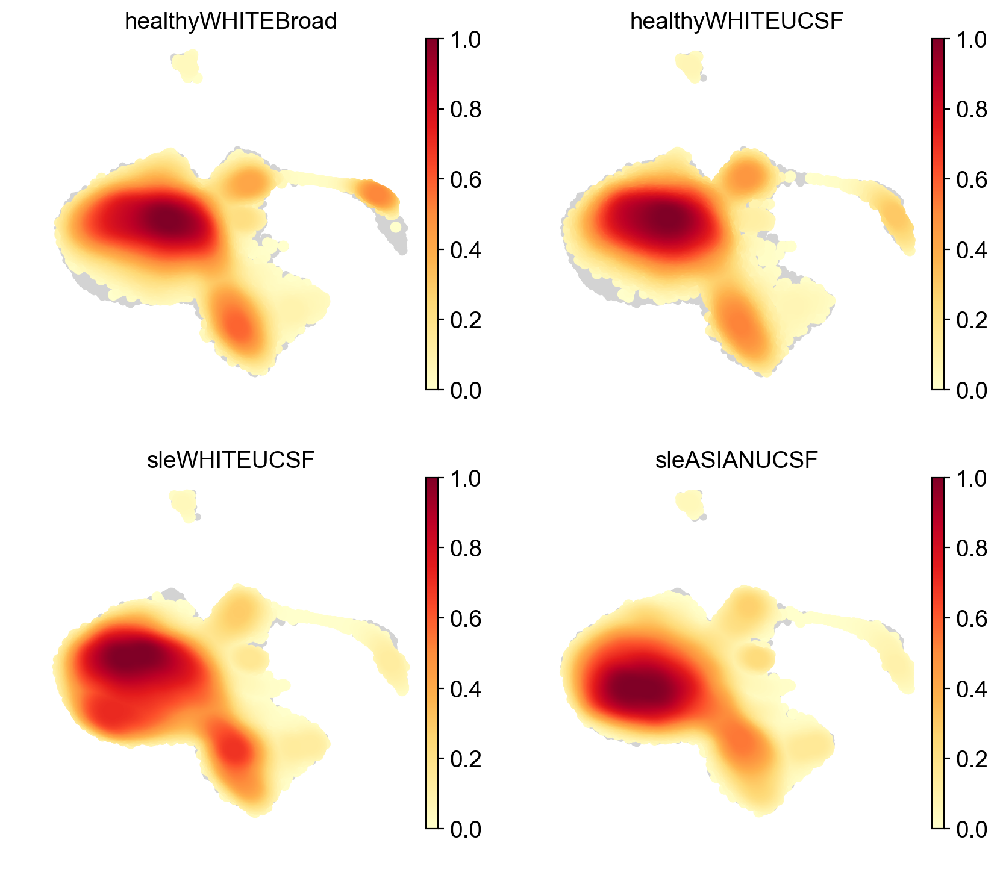

In [6]:
disease_umap = sc.pl.embedding_density(adata, basis="umap", key="umap_density_disease_pop_site_cov", frameon=False, ncols=2)
disease_umap = sc.pl.embedding_density(adata, basis="umap", key="umap_density_disease_pop_site_cov", frameon=False, ncols=2, save=".density.png")

saving figure to file ./figures.V6.1/umap.ct_markers.png


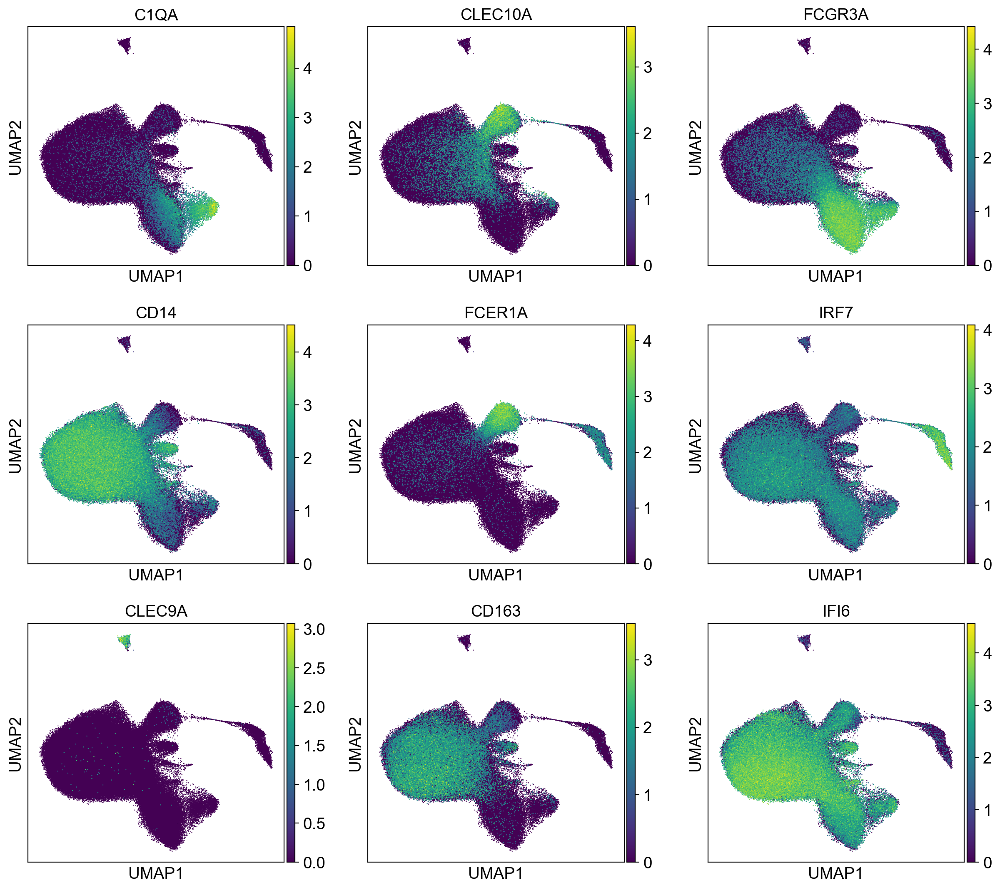

In [7]:
sc.pl.umap(adata, color=['C1QA','CLEC10A','FCGR3A', 'CD14', 'FCER1A', 'IRF7', 'CLEC9A', 'CD163', 'IFI6'], size=3, ncols=3)
sc.pl.umap(adata, color=['C1QA','CLEC10A','FCGR3A', 'CD14', 'FCER1A', 'IRF7', 'CLEC9A', 'CD163', 'IFI6'], size=3, ncols=3, save=".ct_markers.png")

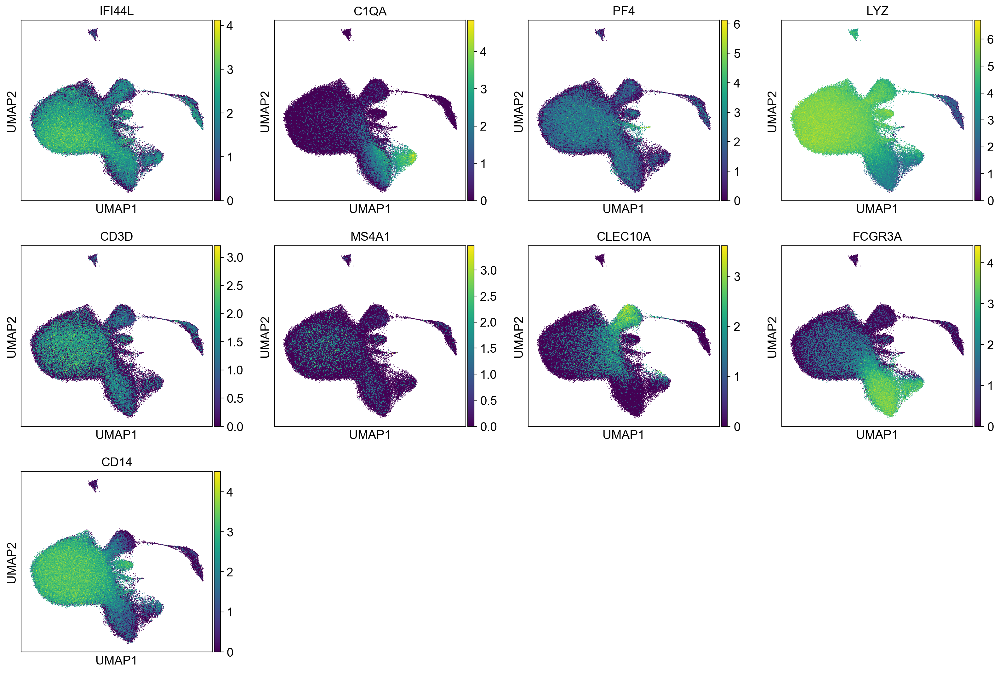

In [8]:
sc.pl.umap(adata, color=['IFI44L','C1QA','PF4','LYZ','CD3D','MS4A1', 'CLEC10A', 'FCGR3A', 'CD14'], size=3)

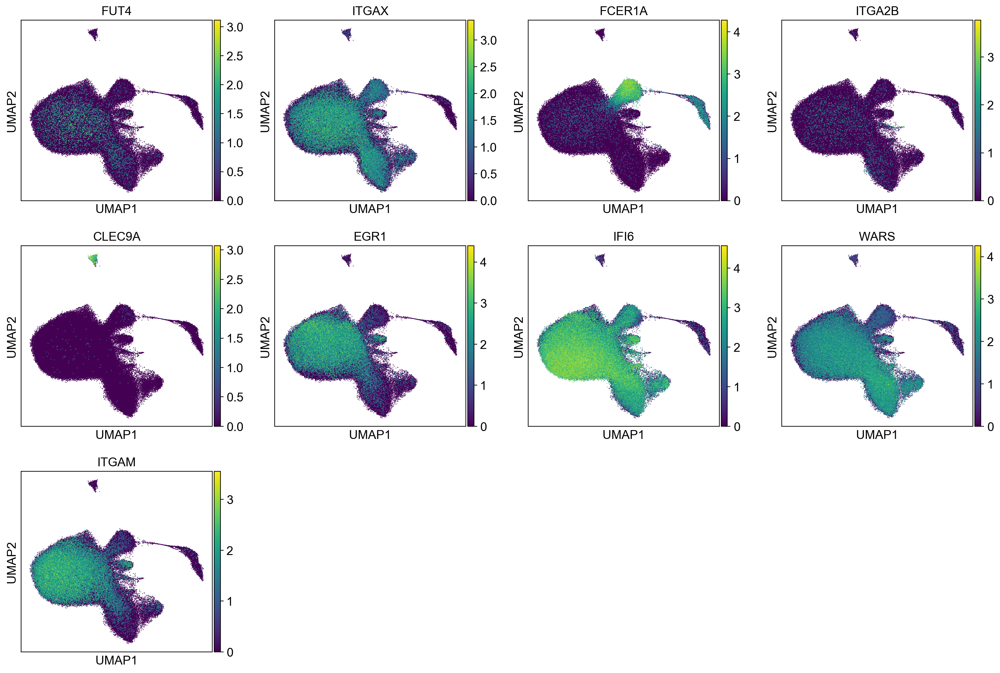

In [9]:
sc.pl.umap(adata, color=['FUT4', 'ITGAX', 'FCER1A', 'ITGA2B', 'CLEC9A', 'EGR1', 'IFI6', 'WARS', 'ITGAM'], size=3)

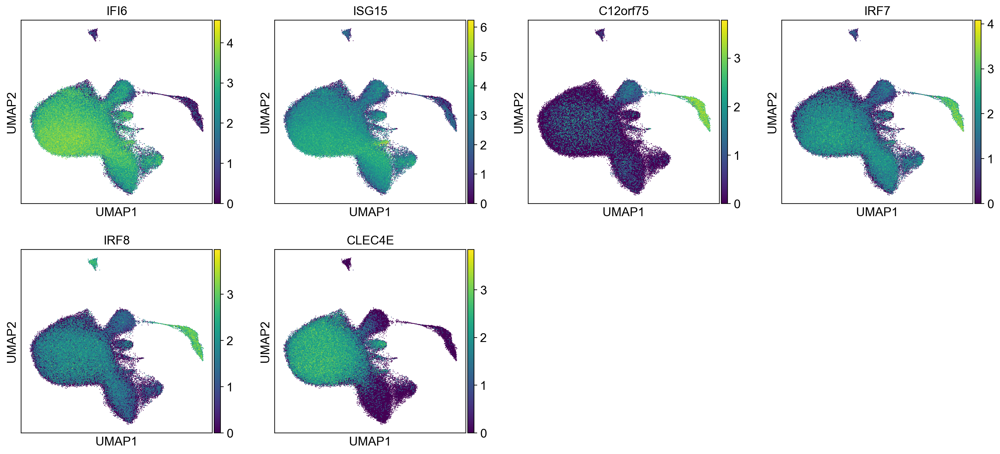

In [10]:
sc.pl.umap(adata, color=['IFI6', 'ISG15', 'C12orf75', 'IRF7', 'IRF8', 'CLEC4E'], size=3)

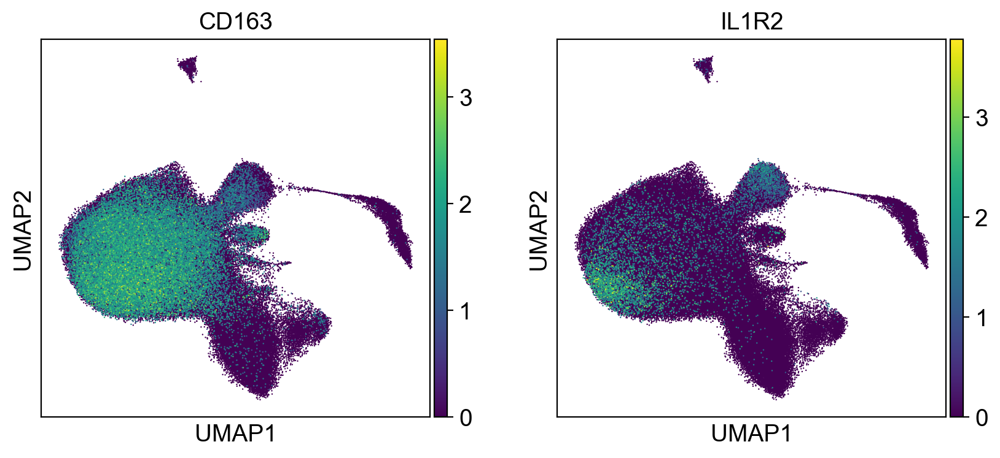

In [11]:
sc.pl.umap(adata, color=['CD163', 'IL1R2'], size=3)

# look at IFN and cell lineage perc

/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: FutureWarning: read_table is deprecated, use read_csv instead.
  """
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2389: FutureWarning: Method .ptp is deprecated and will be removed in a future version. Use numpy.ptp instead.
  return ptp(axis=axis, out=out, **kwargs)


as a proportion of cell type
Cluster type:cM
Beta=1.237837265209619, pvalue=1.1069749801736797e-14
Cluster type:ncM
Beta=0.12481099018470868, pvalue=0.002041367512885798
Cluster type:cDC
Beta=-0.03690267493571106, pvalue=8.47059154665652e-05
Cluster type:pDC
Beta=-0.022996066608325687, pvalue=3.2218876753384006e-07
Cluster type:Th
Beta=-1.32937237234036, pvalue=3.091283904696777e-18
Cluster type:Tc
Beta=0.08768184754286536, pvalue=0.47866009126373144
Cluster type:Th
Beta=-1.32937237234036, pvalue=3.091283904696777e-18
Cluster type:NK
Beta=-0.1579693671966805, pvalue=0.01477477509902297
Cluster type:ProlifT
Beta=0.05351822029588083, pvalue=5.1633310203161424e-12
Cluster type:B
Beta=0.07987827572701356, pvalue=0.514060410562494
Cluster type:MK
Beta=0.007461564013764407, pvalue=0.006361294005270885
Cluster type:Progen
Beta=-0.0012694435159050408, pvalue=0.1941469679233046
as a proportion of cell group
Cluster type:lymph
Beta=-1.263375234781435, pvalue=8.592562283795647e-13
Cluster type:my

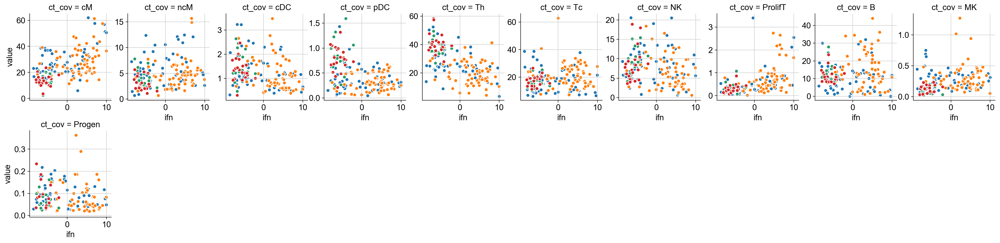

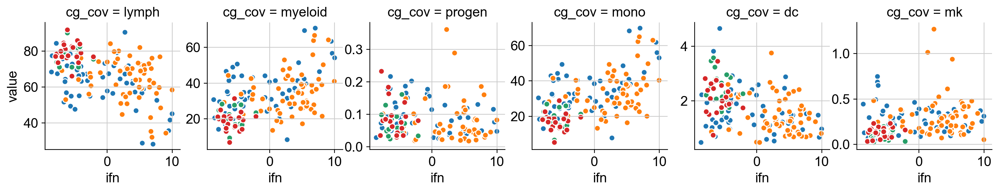

In [12]:
joined_pivot = pd.read_csv("CLUESImmVar_processed."+version+'_joined_pivot_ct_perc.txt',index_col=False)
joined_pivot_cg = pd.read_csv("CLUESImmVar_processed."+version+'_joined_pivot_cg_perc.txt',index_col=False)
joined_pivot_cg["myeloid"] = joined_pivot_cg.mono+joined_pivot_cg.dc

ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
joined_pivot_ifn = ifn.join(joined_pivot.set_index("ind_cov"), on="name")
joined_pivot_cg_ifn = ifn.join(joined_pivot_cg.set_index("ind_cov"), on="name")

cell_types = ["cM", "ncM", "cDC", "pDC", "Th","Tc","Th","NK","ProlifT","B","MK","Progen"];
cg_types = ['lymph', 'myeloid', 'progen', 'mono', 'dc','mk']

index = ["name","ifn","disease_cov","disease_pop_site_cov","batch_cov"];
joined_ifn = pd.melt(joined_pivot_ifn, id_vars=index, value_vars=cell_types, var_name="ct_cov")
joined_cg_ifn = pd.melt(joined_pivot_cg_ifn, id_vars=index, value_vars=cg_types, var_name="cg_cov")

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct in cell_types :
    ##ct = ct_percs.leiden.cat.categories[ct_i]
    ct_perc = joined_pivot_ifn[ct]
    ifn = joined_pivot_ifn.ifn
    ifn = sm.add_constant(ifn)
    print('Cluster type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
g = sb.FacetGrid(joined_ifn, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "ifn", "value", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn.ct_cov.png")

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell group')
for cg in cg_types :
    ##ct = ct_percs.leiden.cat.categories[ct_i]
    cg_perc = joined_pivot_cg_ifn[cg]
    ifn = joined_pivot_cg_ifn.ifn
    ifn = sm.add_constant(ifn)
    print('Cluster type:'+ cg)
    est=sm.OLS(cg_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
g = sb.FacetGrid(joined_cg_ifn, col="cg_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "ifn", "value", edgecolor="w")

g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn.cg_cov.png",height=2)

# Now let's plot differences in cluster proportion for ALL samples including UCSF and Broad ImmVar

## Plotting Louvain

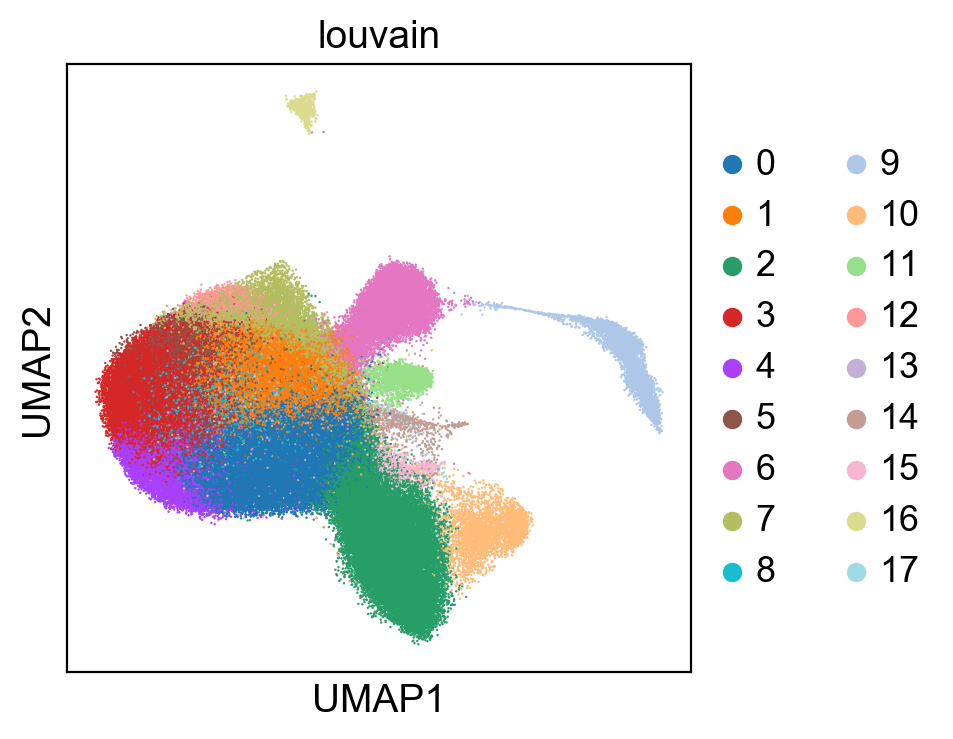

In [13]:
sc.pl.umap(adata, color='louvain', size=3, edgecolor="none")

ranking genes


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/scanpy/tools/_rank_genes_groups.py:222: RuntimeWarning: invalid value encountered in log2
  rankings_gene_logfoldchanges.append(np.log2(foldchanges[global_indices]))


    finished (0:00:38.25)


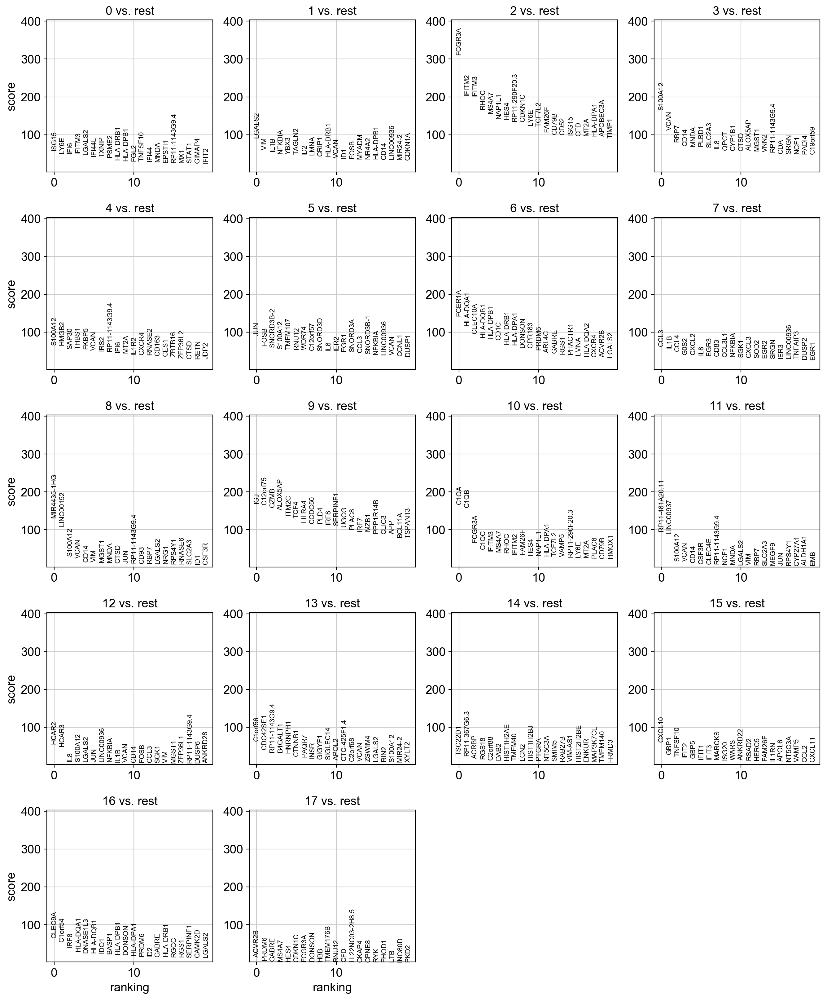

In [14]:
sc.tl.rank_genes_groups(adata, n_genes=20, groupby='louvain', use_raw=False)
sc.pl.rank_genes_groups(adata)

## Plotting Leiden

In [15]:
# sc.pl.umap(adata, color='leiden', size=3, edgecolor="none")

In [16]:
# sc.tl.rank_genes_groups(adata, n_genes=20, groupby='leiden', use_raw=False)
# sc.pl.rank_genes_groups(adata)

In [17]:
# ct_counts=adata.obs.groupby(['ind_cov', 'pop_cov', 'disease_cov', 'batch_cov', 'disease_pop_cov','leiden'])['leiden'].count()

# ##ind_count = ind_count.reset_index(name="counts")
# ct_counts_sums = ct_counts.groupby(["ind_cov","batch_cov"]).sum()
# ct_counts_sums = ct_counts_sums.reset_index(name="counts")

# ct_percs = ct_counts/ct_counts.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ct_percs = ct_percs.reset_index(name='ct_percs')

# ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
# ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
# ct_percs.reset_index(inplace=True)
# ct_percs.leiden = ct_percs.leiden.astype("category")
# ct_df=ct_percs.unstack(level=2, fill_value=0)

# ct_percs['site'] = pd.Categorical(ct_percs.disease_cov, categories=['Broad','UCSF'])
# ct_percs.site[ct_percs.batch_cov.str.contains("immvar")] = "Broad"
# ct_percs.site[~ct_percs.batch_cov.str.contains("immvar")] = "UCSF"

# ct_percs['disease_pop_site_cov'] = pd.Categorical(ct_percs.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
#                                              categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
#                                              ordered=True)


# ##plt.figure(figsize=(20,8))
# plot=sb.catplot(x='disease_pop_site_cov', y='ct_percs', hue='leiden', data=ct_percs, kind='violin', col='leiden', dodge=False, aspect=0.5, height=4, sharex=False, sharey=False, palette=adata.uns['leiden_colors'], cut=0, col_wrap=10) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.4)

# # for ct_i in list(range(len(ct_percs.leiden.cat.categories))) :
# #     ct = ct_percs.leiden.cat.categories[ct_i]
# #     sb.swarmplot(x="disease_pop_site_cov", y="ct_percs", data=ct_percs[ct_percs.leiden == ct], color="0", size=3, ax=plot.axes[0,ct_i])
# #     plot.axes[0,ct_i].get_yaxis().label.set_visible(False)

# #plot.savefig(figdir+"/violin.cd4_pop.png")
# #plt.subplots_adjust(wspace=0.03)

# look at cell types

In [18]:
# adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('object')

# ## do some manual cell type assignment
# adata.obs.loc[adata.obs.leiden == "0","ct_cov"] = "cM" # CCR7, SOCS3-, TNF- CREM-
# adata.obs.loc[adata.obs.leiden == "1","ct_cov"] = "ncM"# CCR7-, GATA3, RORA, CD45+, IL7R, CREM+
# adata.obs.loc[adata.obs.leiden == "2","ct_cov"] = "Mact" # PRF1, CD8+, IL7R-
# adata.obs.loc[adata.obs.leiden == "3","ct_cov"] = "cM" ## is memory above # CD69+, CCR7+, SOCS3+ CREM+
# adata.obs.loc[adata.obs.leiden == "4","ct_cov"] = "cMact" # CCR7+, CD8+
# adata.obs.loc[adata.obs.leiden == "5","ct_cov"] = "cM"# CREM+ CD8+, IL7R+
# adata.obs.loc[adata.obs.leiden == "6","ct_cov"] = "cDC1" # CCR7+, FOXP1+
# adata.obs.loc[adata.obs.leiden == "7","ct_cov"] = "infM"# PRF1+, CD8-, IL7+, CREM-, 
# adata.obs.loc[adata.obs.leiden == "8","ct_cov"] = "iM" # CCR7+ CD8-, S100A4- 
# adata.obs.loc[adata.obs.leiden == "9","ct_cov"] = "pDC" # IL2RA+, CTLA4+, FOXP3+
# adata.obs.loc[adata.obs.leiden == "10","ct_cov"] = "compM" # IFN+, STAT1+
# adata.obs.loc[adata.obs.leiden == "11","ct_cov"] = "Mac1" # clec4e
# adata.obs.loc[adata.obs.leiden == "12","ct_cov"] = "infM" # STMN1+ SOX4+
# adata.obs.loc[adata.obs.leiden == "13","ct_cov"] = "iM" # PTCRA+
# adata.obs.loc[adata.obs.leiden == "14","ct_cov"] = "not sure" # MNDA, CD14, FCER1G
# adata.obs.loc[adata.obs.leiden == "15","ct_cov"] = "Mac2" # STMN1+ SOX4+
# adata.obs.loc[adata.obs.leiden == "16","ct_cov"] = "cDC2" # PTCRA+
# adata.obs.loc[adata.obs.leiden == "17","ct_cov"] = "ncMact" # MNDA, CD14, FCER1G

# adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('category')

In [19]:
adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('object')

## do some manual cell type assignment
adata.obs.loc[adata.obs.louvain == "0","ct_cov"] = "cMact" # CCR7, SOCS3-, TNF- CREM-
adata.obs.loc[adata.obs.louvain == "1","ct_cov"] = "cMinf"# CCR7-, GATA3, RORA, CD45+, IL7R, CREM+
adata.obs.loc[adata.obs.louvain == "2","ct_cov"] = "ncM" # PRF1, CD8+, IL7R-
adata.obs.loc[adata.obs.louvain == "3","ct_cov"] = "cM" ## is memory above # CD69+, CCR7+, SOCS3+ CREM+
adata.obs.loc[adata.obs.louvain == "4","ct_cov"] = "cMact" # CCR7+, CD8+
adata.obs.loc[adata.obs.louvain == "5","ct_cov"] = "cM"# CREM+ CD8+, IL7R+
adata.obs.loc[adata.obs.louvain == "6","ct_cov"] = "cDC1" # CCR7+, FOXP1+
adata.obs.loc[adata.obs.louvain == "7","ct_cov"] = "cMinf"# PRF1+, CD8-, IL7+, CREM-, 
adata.obs.loc[adata.obs.louvain == "8","ct_cov"] = "cM" # CCR7+ CD8-, S100A4- 
adata.obs.loc[adata.obs.louvain == "9","ct_cov"] = "pDC" # IL2RA+, CTLA4+, FOXP3+
adata.obs.loc[adata.obs.louvain == "10","ct_cov"] = "ncMcomp" # IFN+, STAT1+
adata.obs.loc[adata.obs.louvain == "11","ct_cov"] = "Mac1" # clec4e
adata.obs.loc[adata.obs.louvain == "12","ct_cov"] = "cM" # STMN1+ SOX4+
adata.obs.loc[adata.obs.louvain == "13","ct_cov"] = "cMinf" # PTCRA+
adata.obs.loc[adata.obs.louvain == "14","ct_cov"] = "Mac2" # MNDA, CD14, FCER1G
adata.obs.loc[adata.obs.louvain == "15","ct_cov"] = "Mac2" # STMN1+ SOX4+
adata.obs.loc[adata.obs.louvain == "16","ct_cov"] = "cDC2" # PTCRA+
adata.obs.loc[adata.obs.louvain == "17","ct_cov"] = "Mac2" # MNDA, CD14, FCER1G

adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('category')

adata.obs.ct_cov = adata.obs.ct_cov.cat.reorder_categories(['cM', 'cMact', 'cMinf', 'Mac1', 'Mac2', 'ncM', 'ncMcomp', 'cDC1', 'cDC2', 'pDC'])

saving figure to file ./figures.V6.1/umap.ct_cov.all.png


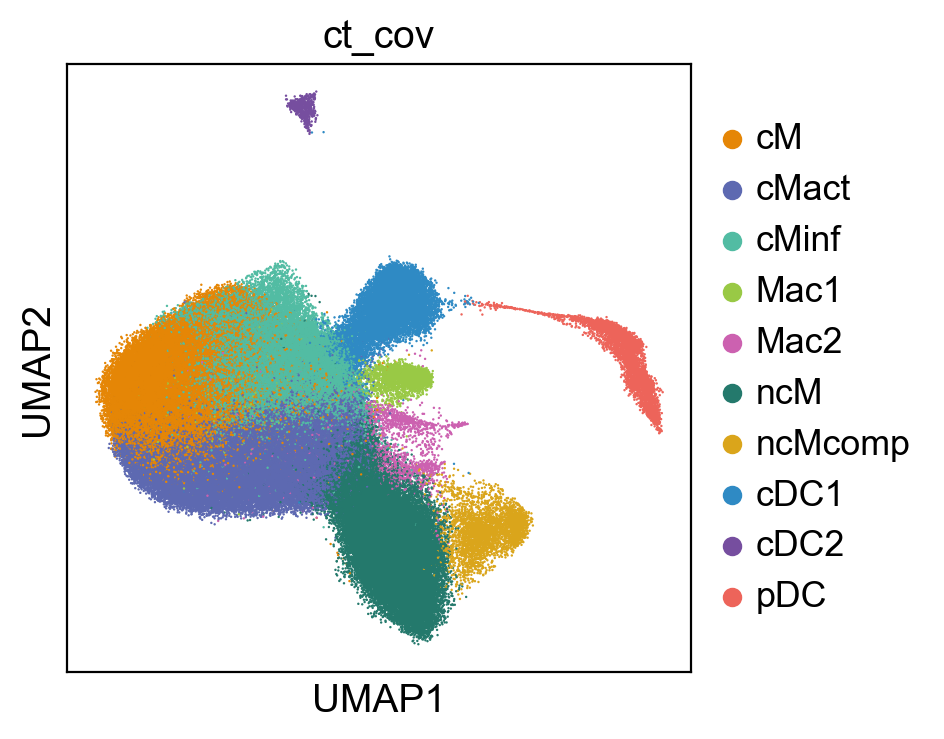

In [20]:
adata.uns['ct_cov_colors'] = ["#E58606","#5D69B1","#52BCA3","#99C945","#CC61B0","#24796C","#DAA51B","#2F8AC4","#764E9F","#ED645A","#CC3A8E","#A5AA99"]

sc.pl.umap(adata, color='ct_cov', size=3, edgecolor="none")
sc.pl.umap(adata, color='ct_cov', size=3, save=".ct_cov.all.png")

In [21]:
def marker_gene_expression(anndata, marker_dict, gene_symbol_key=None, partition_key='louvain_r1'):
    """A function go get mean z-score expressions of marker genes
    # 
    # Inputs:
    #    anndata         - An AnnData object containing the data set and a partition
    #    marker_dict     - A dictionary with cell-type markers. The markers should be stores as anndata.var_names or 
    #                      an anndata.var field with the key given by the gene_symbol_key input
    #    gene_symbol_key - The key for the anndata.var field with gene IDs or names that correspond to the marker 
    #                      genes
    #    partition_key   - The key for the anndata.obs field where the cluster IDs are stored. The default is
    #                      'louvain_r1' """

    #Test inputs
    if partition_key not in anndata.obs.columns.values:
        print('KeyError: The partition key was not found in the passed AnnData object.')
        print('   Have you done the clustering? If so, please tell pass the cluster IDs with the AnnData object!')
        raise

    if (gene_symbol_key != None) and (gene_symbol_key not in anndata.var.columns.values):
        print('KeyError: The provided gene symbol key was not found in the passed AnnData object.')
        print('   Check that your cell type markers are given in a format that your anndata object knows!')
        raise
        

    if gene_symbol_key:
        gene_ids = anndata.var[gene_symbol_key]
    else:
        gene_ids = anndata.var_names

    clusters = anndata.obs[partition_key].cat.categories
    n_clust = len(clusters)
    marker_exp = pd.DataFrame(columns=clusters)
    marker_exp['cell_type'] = pd.Series({}, dtype='str')
    marker_names = []
    
    z_scores = sc.pp.scale(anndata, copy=True)

    i = 0
    for group in marker_dict:
        # Find the corresponding columns and get their mean expression in the cluster
        for gene in marker_dict[group]:
            ens_idx = np.in1d(gene_ids, gene) #Note there may be multiple mappings
            if np.sum(ens_idx) == 0:
                continue
            else:
                z_scores.obs[ens_idx[0]] = z_scores.X[:,ens_idx].mean(1) #works for both single and multiple mapping
                ens_idx = ens_idx[0]

            clust_marker_exp = z_scores.obs.groupby(partition_key)[ens_idx].apply(np.mean).tolist()
            clust_marker_exp.append(group)
            marker_exp.loc[i] = clust_marker_exp
            marker_names.append(gene)
            i+=1

    #Replace the rownames with informative gene symbols
    marker_exp.index = marker_names

    return(marker_exp)

In [22]:
marker_dictionary = pd.DataFrame({"all": adata.var_names})

rst = marker_gene_expression(adata, marker_dictionary, partition_key="ct_cov")

rst.to_csv("myeloid_expr.ct_cov.csv")

ranking genes
    finished (0:00:22.76)


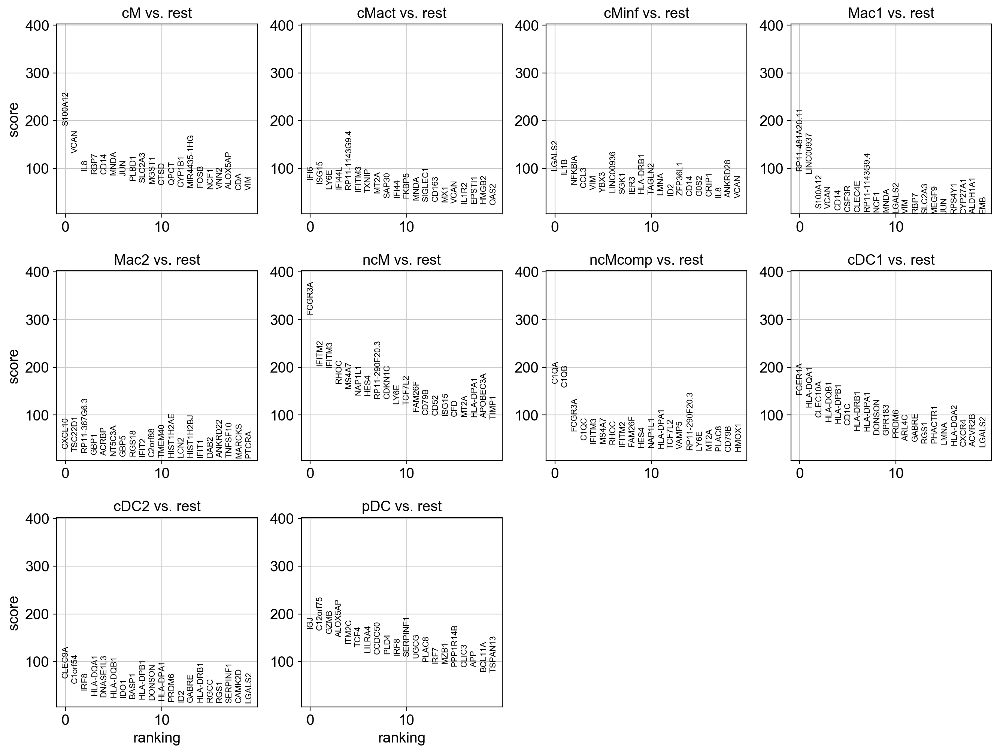

In [23]:
sc.tl.rank_genes_groups(adata, n_genes=20, groupby='ct_cov', use_raw=False)
sc.pl.rank_genes_groups(adata)

In [24]:
pd.set_option('display.max_columns', None)
unique_ct_cov = np.unique(adata.obs['ct_cov'].values)
# Compile list of top genes
GeneRanks = pd.DataFrame()
for ii in range(len(unique_ct_cov)):
    GeneRanks[unique_ct_cov[ii]] = adata.var_names[np.flipud(np.argsort(np.mean(adata.X[adata.obs['ct_cov'] == unique_ct_cov[ii]], axis=0)))]
##GeneRanks.to_csv('FLARE_top_expression.csv')
GeneRanks.head(20)

,Mac1,Mac2,cDC1,cDC2,cM,cMact,cMinf,ncM,ncMcomp,pDC
0,RP11-481A20.11,CXCL10,FCER1A,CLEC9A,S100A12,IFI6,LGALS2,FCGR3A,C1QB,LILRA4
1,LINC00937,RP11-367G6.3,CLEC10A,IDO1,VCAN,ISG15,IL1B,RHOC,C1QA,IGJ
2,S100A12,TSC22D1,CD1C,C1orf54,IL8,IFI44L,CCL3,CDKN1C,C1QC,ITM2C
3,VCAN,C2orf88,HLA-DQA1,DNASE1L3,RBP7,LY6E,NFKBIA,HES4,FCGR3A,SERPINF1
4,CD14,LCN2,HLA-DQB1,IRF8,CD14,RP11-1143G9.4,VIM,IFITM2,RHOC,GZMB
5,CSF3R,TMEM40,HLA-DPB1,BASP1,MNDA,IFITM3,LMNA,IFITM3,HES4,MZB1
6,CLEC4E,ACRBP,GPR183,S100B,JUN,MT2A,YBX3,MS4A7,MS4A7,TPM2
7,RP11-1143G9.4,HIST1H2BJ,LMNA,HLA-DQA1,PLBD1,SAP30,SGK1,TCF7L2,LYPD2,SCT
8,MNDA,HIST1H2AE,HLA-DPA1,SERPINF1,QPCT,TXNIP,LINC00936,RP11-290F20.3,TCF7L2,LRRC26
9,NCF1,RAB27B,HLA-DRB1,HLA-DQB1,SLC2A3,IFI44,IER3,NAP1L1,IFITM3,DERL3


saving figure to file ./figures.V6.1/stacked_violin.violin.png


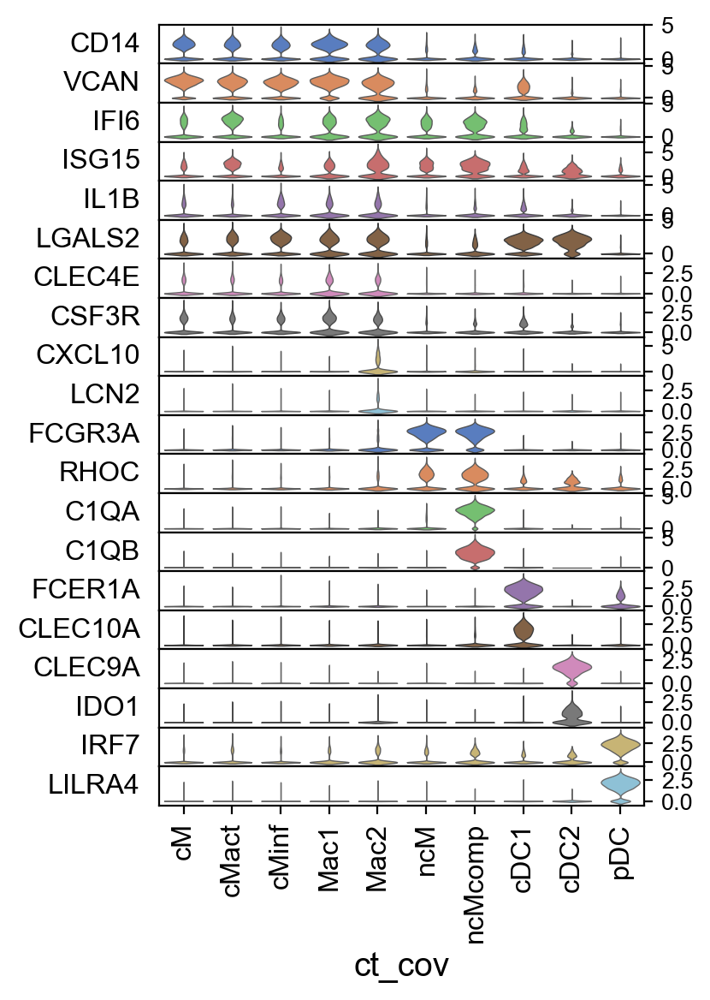

In [25]:
sc.pl.stacked_violin(adata, var_names=['CD14','VCAN','IFI6','ISG15','IL1B','LGALS2','CLEC4E','CSF3R','CXCL10','LCN2','FCGR3A','RHOC','C1QA','C1QB','FCER1A','CLEC10A', 'CLEC9A','IDO1','IRF7','LILRA4'], groupby="ct_cov", swap_axes= True)
sc.pl.stacked_violin(adata, var_names=['CD14','VCAN','IFI6','ISG15','IL1B','LGALS2','CLEC4E','CSF3R','CXCL10','LCN2','FCGR3A','RHOC','C1QA','C1QB','FCER1A','CLEC10A','CLEC9A','IDO1','IRF7','LILRA4'], groupby="ct_cov", save=".violin.png", swap_axes=True)

In [ ]:
## calculating percentage effect using code from figure 1

In [26]:
# ## Make proportion plots (Fig. 1D)

# ##adata_obs_small = adata.obs[(adata.obs.study_cov=="ImmVar") & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & (adata.obs.study_cov=="CLUES"))]
# ##adata_obs_small = adata.obs[(adata.obs.well.str.contains("immvar")) & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & ~adata.obs.well.str.contains("immvar"))]
# adata_obs_small = adata.obs;##[(adata.obs.batch_cov.str.contains("lupus"))]

# ##ind_count = adata_obs_small.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

# ## no batch_cov so that we aggregate the count for the two healthy controls
# ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov','batch_cov','site', "disease_pop_site_cov"])['ct_cov'].count()

# ##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
# ##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

# ##ind_count = ind_count.reset_index(name="counts")
# ind_count_sums = ind_count.groupby(["ind_cov","batch_cov"]).sum()
# ind_count_sums = ind_count_sums.reset_index(name="counts")

# ##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ind_perc = ind_perc.reset_index(name="ct_perc")

# ## filter samples that have < 100 cells
# ind_perc = ind_perc[ind_perc.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]


In [27]:
# print("ind_perc.shape: ",ind_perc.shape)
# print("ind_count_sums.shape: ", ind_count_sums.shape)
# print("len(ind_perc.ind_cov): ", len(ind_perc.ind_cov))
# print("len(ind_perc.ind_cov.unique): ", len(ind_perc.ind_cov.unique()))

# ## for now, let's filter out one of the reps for the healthies from UCSF only
# ## and filter out any broad samples that were replicated at UCSF
# ind_perc_broad = ind_perc[~ind_perc.batch_cov.str.contains("lupus")]
# ind_perc_ucsf = ind_perc[ind_perc.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ct_cov','ind_cov'])
# ind_perc_all = ind_perc_ucsf.append(ind_perc_broad);

# ind_count_sums_broad = ind_count_sums[~ind_count_sums.batch_cov.str.contains("lupus")]
# ind_count_sums_ucsf = ind_count_sums[ind_count_sums.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
# ind_count_sums_all = ind_count_sums_ucsf.append(ind_count_sums_broad);

# print(ind_perc.shape)
# print(ind_count_sums.shape)

# ##ind_count = ind_count.drop_duplicates(subset=['ct_cov','ind_cov'])

In [28]:
# cg_cov = pd.DataFrame( {'ct_cov':['B','cM','ncM', 'Th', 'Tc', 'NK', 'ProlifT', 'cDC', 'pDC', 'MK', 'Progen'], 'cg_cov':['lymph', 'mono', 'mono', 'lymph','lymph', 'lymph', 'lymph', 'dc','dc', 'mk', 'progen']})
# ind_perc_all.ind_cov = ind_perc_all.ind_cov.apply(lambda x: x.split('_')[0])
# ind_count_sums_all.ind_cov = ind_count_sums_all.ind_cov.apply(lambda x: x.split('_')[0])
# ind_perc_all = ind_perc_all.set_index('ct_cov').join(cg_cov.set_index('ct_cov'))
# ind_perc_all.ind_cov = ind_perc_all.ind_cov.astype("str")
# ind_perc_all.batch_cov = ind_perc_all.batch_cov.astype("str")
# ind_perc_all.reset_index(inplace=True)
# ind_perc_all.ct_cov = ind_perc_all.ct_cov.astype('category')
# ind_perc_all.ct_cov = ind_perc_all.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)
# ## do this to get monos and lympho to have similar colors as the major cell types
# ind_perc_all.cg_cov = ind_perc_all.cg_cov.astype('category')
# ind_perc_all.cg_cov = ind_perc_all.cg_cov.cat.reorder_categories(["mono", "dc", "mk", "progen","lymph"])

# ind_perc = ind_perc_all.drop_duplicates(subset=['ct_cov','ind_cov']);
# ind_count_sums = ind_count_sums_all.drop_duplicates(subset=['ind_cov']);


## ordinary least squares

In [29]:
# ind_perc = ind_perc_all.drop_duplicates(subset=['ct_cov','ind_cov']);
# ind_count_sums = ind_count_sums_all.drop_duplicates(subset=['ind_cov']);

In [30]:

# print('as a proportion of total PBMC ')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
    
# print('\nwhite sle vs white healthy')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc[ind_perc.pop_cov=="WHITE"].ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc[ind_perc.pop_cov=="WHITE"].disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
# print('\nasian sle vs white healthy')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
# print('\nwhite sle vs asian sle')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc[ind_perc.disease_cov=="sle"].ct_perc[ind_perc.ct_cov==ct]
#     pop = ind_perc[ind_perc.disease_cov=="sle"].pop_cov[ind_perc.ct_cov==ct]
#     pop = pop.astype("str")
#     pop.values[pop=="ASIAN"] = 0
#     pop.values[pop=="WHITE"] = 1
#     pop = sm.add_constant(pop)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), pop.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))

## weighted least squares using total pbmc counts

In [31]:
# print('as a proportion of total PBMC ')

# all_out = pd.DataFrame()

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
    
#     weights = ind_perc[ind_perc.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     ##r2=est.rsquared
    
#     all_out = all_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(all_out);

# print('\nwhite sle vs white healthy')

# white_out = pd.DataFrame();

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ind_perc_small = ind_perc[ind_perc.pop_cov=="WHITE"];
    
#     ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
#     disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
    
#     weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)

#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
    
#     white_out = white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(white_out); ##print(white_out)

# asian_sle_white_out = pd.DataFrame();
    
# print('\nasian sle vs white healthy')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ind_perc_small = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))]
   
#     ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
#     disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
    
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
    
#     weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     asian_sle_white_out = asian_sle_white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(asian_sle_white_out); ##print(white_out) 
  
# print('\nwhite sle vs asian sle')

# asian_white_sle_out = pd.DataFrame();

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ind_perc_small = ind_perc[ind_perc.disease_cov=="sle"];
    
#     ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
#     pop = ind_perc_small.pop_cov[ind_perc_small.ct_cov==ct]
    
#     pop = pop.astype("str")
#     pop.values[pop=="ASIAN"] = 0
#     pop.values[pop=="WHITE"] = 1
#     pop = sm.add_constant(pop)
   
#     ##data = data.assign(ct_perc=ct_perc)
#     weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), pop.astype(float), weights=weights)
    
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     asian_white_sle_out = asian_white_sle_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(asian_white_sle_out); ##print(white_out)  

## let's do WLS as a total number of PBMCs

In [123]:
## Make proportion plots (Fig. 1D)

##adata_obs_small = adata.obs[(adata.obs.study_cov=="ImmVar") & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & (adata.obs.study_cov=="CLUES"))]
##adata_obs_small = adata.obs[(adata.obs.well.str.contains("immvar")) & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & ~adata.obs.well.str.contains("immvar"))]
adata_obs_small = adata.obs;##[(adata.obs.batch_cov.str.contains("lupus"))]

##ind_count = adata_obs_small.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

## no batch_cov so that we aggregate the count for the two healthy controls
ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov','batch_cov','site','disease_pop_site_cov'])['ct_cov'].count()

##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

##ind_count = ind_count.reset_index(name="counts")
ind_count_sums = ind_count.groupby(["ind_cov","batch_cov"]).sum()
ind_count_sums = ind_count_sums.reset_index(name="counts")

##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
ind_count = ind_count.reset_index(name="ct_count")

## filter samples that have < 100 cells
ind_count = ind_count[ind_count.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]


ind_count.ind_cov = ind_count.ind_cov.apply(lambda x: x.split('_')[0])
ind_count_sums.ind_cov = ind_count_sums.ind_cov.apply(lambda x: x.split('_')[0])
ind_count.ind_cov = ind_count.ind_cov.astype("str")
ind_count.batch_cov = ind_count.batch_cov.astype("str")
ind_count.reset_index(inplace=True)
ind_count.ct_cov = ind_count.ct_cov.astype('category')
ind_count.ct_cov = ind_count.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)

ind_count = ind_count.join(joined_pivot.set_index(["ind_cov", 'disease_cov', 'batch_cov','disease_pop_site_cov']), on=["ind_cov", 'disease_cov', 'batch_cov','disease_pop_site_cov'])
ind_count = ind_count[~np.isnan(ind_count.pbmc_counts)]

ind_perc = ind_count;
ind_perc["ct_perc"] = ind_count.ct_count/ind_count.pbmc_counts*100


In [124]:
print("ind_count.shape: ",ind_count.shape)
print("ind_count_sums.shape: ", ind_count_sums.shape)
print("len(ind_count.ind_cov): ", len(ind_count.ind_cov))
print("len(ind_count.ind_cov.unique): ", len(ind_count.ind_cov.unique()))

## for now, let's filter out one of the reps for the healthies from UCSF only
## and filter out any broad samples that were replicated at UCSF
ind_perc_broad = ind_perc[~ind_perc.batch_cov.str.contains("lupus")]
ind_perc_ucsf = ind_perc[ind_perc.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ct_cov','ind_cov'])
ind_perc_all = ind_perc_ucsf.append(ind_perc_broad);

ind_count_broad = ind_count[~ind_count.batch_cov.str.contains("lupus")]
ind_count_ucsf = ind_count[ind_count.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
ind_count_all = ind_count_ucsf.append(ind_count_broad);

ind_count_sums_broad = ind_count_sums[~ind_count_sums.batch_cov.str.contains("lupus")]
ind_count_sums_ucsf = ind_count_sums[ind_count_sums.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
ind_count_sums_all = ind_count_sums_ucsf.append(ind_count_sums_broad);

ind_count.shape:  (1846, 77)
ind_count_sums.shape:  (206, 3)
len(ind_count.ind_cov):  1846
len(ind_count.ind_cov.unique):  169


## plot the figures

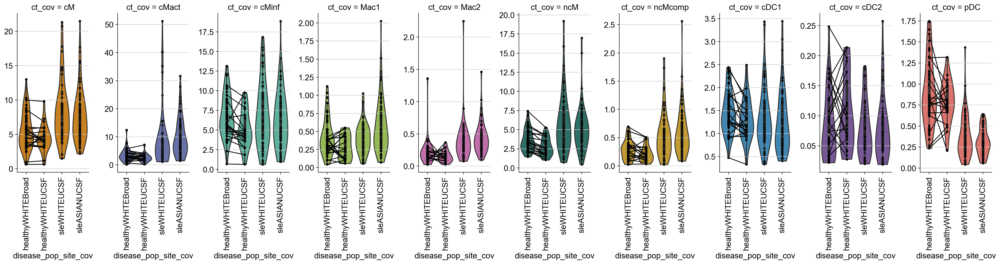

In [125]:
##plt.figure(figsize=(20,8))

ind_perc_all['site'] = pd.Categorical(ind_perc_all.disease_cov, categories=['Broad','UCSF'])
ind_perc_all.site[ind_perc_all.batch_cov.str.contains("immvar")] = "Broad"
ind_perc_all.site[~ind_perc_all.batch_cov.str.contains("immvar")] = "UCSF"

ind_perc_all['disease_pop_cov'] = pd.Categorical(ind_perc_all.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1),
                                             categories=['healthyWHITE','sleWHITE','sleASIAN'],
                                             ordered=True)

ind_perc_all['disease_pop_site_cov'] = pd.Categorical(ind_perc_all.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
                                             categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
                                             ordered=True)


plot=sb.catplot(x='disease_pop_site_cov', y='ct_perc', hue='ct_cov', data=ind_perc_all, kind='violin', col='ct_cov', 
                dodge=False, aspect=0.5, height=5, sharex=False, sharey=False, cut=0, col_wrap=10,
               palette = ["#E58606","#5D69B1","#52BCA3","#99C945","#CC61B0","#24796C","#DAA51B","#2F8AC4","#764E9F","#ED645A","#CC3A8E","#A5AA99"]) #, palette=sc.pl.palettes.vega_20_scanpy
plot.set_xticklabels(rotation=90)
plot.fig.subplots_adjust(wspace=0.4, hspace=0.75)

for ct_i in list(range(len(ind_perc_all.ct_cov.cat.categories))) :
    ct = ind_perc_all.ct_cov.cat.categories[ct_i]
    
    sb.pointplot(x="disease_pop_site_cov", y="ct_perc", hue = "ind_cov", data=ind_perc_all[ind_perc_all.ct_cov == ct], color="0", scale=0.5,
                 ax=plot.axes[ct_i], legend=False)
    
    plot.axes[ct_i].get_yaxis().label.set_visible(False)
    plot.axes[ct_i].get_legend().remove()
    
    plot.axes[ct_i].get_yaxis().label.set_visible(False)

plot.savefig(figdir+"/violin.myeloid.png")


## weighted least squares using total pbmc counts

In [38]:
# ##cg_cov = pd.DataFrame( {'ct_cov':['B','cM','ncM', 'Th', 'Tc', 'NK', 'ProlifT', 'cDC', 'pDC', 'MK', 'Progen'], 'cg_cov':['lymph', 'mono', 'mono', 'lymph','lymph', 'lymph', 'lymph', 'dc','dc', 'mk', 'progen']})
# ind_count_all = ind_count_all[~np.isnan(ind_count_all.pbmc_counts)]
# ind_perc_all = ind_perc_all[~np.isnan(ind_count_all.pbmc_counts)]


ind_count = ind_count_all.drop_duplicates(subset=['ct_cov','ind_cov']);
ind_count_sums = ind_count_sums_all.drop_duplicates(subset=['ind_cov']);
ind_perc = ind_perc.drop_duplicates(subset=['ct_cov','ind_cov']);

##ind_count = ind_count.join(joined_pivot.set_index(["ind_cov", 'disease_cov', 'batch_cov']), on=["ind_cov", 'disease_cov', 'batch_cov'])

## let's remove the nan entries. these are likely due to small cell numbers
# ind_count = ind_count[~np.isnan(ind_count.pbmc_counts)]
# ind_perc = ind_count;
# ind_perc["ct_perc"] = ind_count.ct_count/ind_count.pbmc_counts*100

In [39]:
print('as a proportion of total PBMC ')

all_out = pd.DataFrame()

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc[ind_perc.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    ##r2=est.rsquared
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    all_out = all_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(all_out);

print('\nwhite sle vs white healthy')

white_out = pd.DataFrame();

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[ind_perc.pop_cov=="WHITE"];
    
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)

    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    white_out = white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(white_out); ##print(white_out)

asian_sle_white_out = pd.DataFrame();
    
print('\nasian sle vs white healthy')

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))]
   
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
    
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    asian_sle_white_out = asian_sle_white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(asian_sle_white_out); ##print(white_out) 
  
print('\nwhite sle vs asian sle')

asian_white_sle_out = pd.DataFrame();

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[ind_perc.disease_cov=="sle"];
    
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    pop = ind_perc_small.pop_cov[ind_perc_small.ct_cov==ct]
    
    pop = pop.astype("str")
    pop.values[pop=="ASIAN"] = 0
    pop.values[pop=="WHITE"] = 1
    pop = sm.add_constant(pop)
   
    ##data = data.assign(ct_perc=ct_perc)
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), pop.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    asian_white_sle_out = asian_white_sle_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(asian_white_sle_out); ##print(white_out)  

as a proportion of total PBMC 


,Beta,Cell,LogFC,Pval
0,-2.4913904100464626,cM,-0.5303654692368822,0.0003374860642821542
1,-5.663884436318822,cMact,-1.3961545337623849,2.4708992802920195e-05
2,0.11685107395275862,cMinf,0.02489527228843615,0.8532156862990768
3,-0.06188613300503243,Mac1,-0.19256609492673485,0.24750486816778322
4,-0.1965305313285689,Mac2,-0.9490776259674889,1.9933024554233132e-05
5,-1.7748336656472028,ncM,-0.576567367096294,0.0006353881236708505
6,-0.2698044964799544,ncMcomp,-0.9578572911380019,3.718183769132784e-05
7,0.22057359297650644,cDC1,0.23166035007456567,0.04132906490172937
8,0.001354578176098616,cDC2,0.02548047327596495,0.8877768063393439
9,0.5631744025494727,pDC,1.4099424704802486,9.869299722483444e-25



white sle vs white healthy


,Beta,Cell,LogFC,Pval
0,-2.890754748660205,cM,-0.5998076815043604,0.00021031254342595274
1,-5.305220926913194,cMact,-1.3383649089489658,0.0009615622287725762
2,-0.1434140020493243,cMinf,-0.029978778598095886,0.8355029251709747
3,0.027146596327330047,Mac1,0.09332086786048371,0.5460999784939466
4,-0.16760958316091132,Mac2,-0.8429285995485996,0.0015382289059205107
5,-2.1597452195602074,ncM,-0.676127658262119,0.0002598096252024601
6,-0.2349239659602045,ncMcomp,-0.8644026531405675,0.00026306121703256063
7,0.1669744694186686,cDC1,0.1718525742374051,0.1462783246408405
8,0.002512208014474212,cDC2,0.04761864913281788,0.8096330995688246
9,0.5311343696050476,pDC,1.2799540640087061,8.494213588971694e-14



asian sle vs white healthy


,Beta,Cell,LogFC,Pval
0,-2.1544196379449536,cM,-0.4690548063951244,0.001683385757711874
1,-5.96651315902494,cMact,-1.443177153667542,6.666916390729432e-08
2,0.33645436631458053,cMinf,0.07287717879807323,0.602039355878415
3,-0.13569394431647291,Mac1,-0.39297343618288355,0.035550908884619904
4,-0.2209330963342264,Mac2,-1.0329417001396923,1.8459078034981585e-06
5,-1.450057687994616,ncM,-0.48686323248066127,0.002322254717879067
6,-0.2992355652162101,ncMcomp,-1.0322596355064095,1.750424539417437e-05
7,0.2657988079066689,cDC1,0.28412742065875507,0.02103682217515358
8,0.0003755834852184818,cDC2,0.007019990758747643,0.972954844336424
9,0.5906314806819732,pDC,1.5314894851694931,3.05428652007419e-20



white sle vs asian sle


,Beta,Cell,LogFC,Pval
0,0.7363351107152522,cM,0.13075287510923625,0.34621884997301733
1,-0.6612922321117458,cMact,-0.10481224471857585,0.6752964398087338
2,0.4798683683639048,cMinf,0.10285595739616932,0.5022461295567014
3,-0.16284054064380296,Mac1,-0.4862943040433664,0.005512915635373648
4,-0.05332351317331517,Mac2,-0.19001310059109264,0.28588199634256556
5,0.7096875315655913,ncM,0.18926442578145772,0.2384898257718135
6,-0.06431159925600552,ncMcomp,-0.16785698236584126,0.3943568690896785
7,0.09882433848800032,cDC1,0.11227484642134981,0.41232941980036997
8,-0.002136624529255742,cDC2,-0.04059865837407011,0.8266788226364243
9,0.05949711107692533,pDC,0.2515354211607872,0.11920655579530628


In [ ]:
# ##plt.figure(figsize=(20,8))
# plot=sb.catplot(x='disease_pop_site_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', 
#                 dodge=False, aspect=0.5, height=5, sharex=False, sharey=False, cut=0, col_wrap=10,
#                palette = ["#E58606","#5D69B1","#52BCA3","#99C945","#CC61B0","#24796C","#DAA51B","#2F8AC4","#764E9F","#ED645A","#CC3A8E","#A5AA99"]) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.4, hspace=0.75)

# for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
    
#     sb.pointplot(x="disease_pop_site_cov", y="ct_perc", hue = "ind_cov", data=ind_perc[ind_perc.ct_cov == ct], color="0", scale=0.5,
#                  ax=plot.axes[ct_i], legend=False)
    
#     plot.axes[ct_i].get_yaxis().label.set_visible(False)
#     plot.axes[ct_i].get_legend().remove()
    
#     plot.axes[ct_i].get_yaxis().label.set_visible(False)

# plot.savefig(figdir+"/violin.myeloid.png")


In [ ]:
# ##plt.figure(figsize=(20,8))
# plot=sb.catplot(x='disease_pop_site_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', 
#                 dodge=False, aspect=0.5, height=5, sharex=False, sharey=False, cut=0, col_wrap=10,
#                palette = ["#E58606","#5D69B1","#52BCA3","#99C945","#CC61B0","#24796C","#DAA51B","#2F8AC4","#764E9F","#ED645A","#CC3A8E","#A5AA99"]) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.4, hspace=0.75)

# for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
    
#     sb.pointplot(x="disease_pop_site_cov", y="ct_perc", hue = "ind_cov", data=ind_perc[ind_perc.ct_cov == ct], color="0", scale=0.5,
#                  ax=plot.axes[ct_i], legend=False)
    
#     plot.axes[ct_i].get_yaxis().label.set_visible(False)
#     plot.axes[ct_i].get_legend().remove()
    
#     plot.axes[ct_i].get_yaxis().label.set_visible(False)

# plot.savefig(figdir+"/violin.myeloid.png")


In [ ]:
# ct_counts=adata.obs.groupby(['ind_cov', 'pop_cov', 'disease_cov', 'batch_cov', 'disease_pop_cov','ct_cov'])['ct_cov'].count()

# ##ind_count = ind_count.reset_index(name="counts")
# ct_counts_sums = ct_counts.groupby(["ind_cov","batch_cov"]).sum()
# ct_counts_sums = ct_counts_sums.reset_index(name="counts")

# ct_percs = ct_counts/ct_counts.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ct_percs = ct_percs.reset_index(name='ct_percs')

# ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
# ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
# ct_percs.reset_index(inplace=True)
# ct_percs.ct_cov = ct_percs.ct_cov.astype("category")
# ct_df=ct_percs.unstack(level=2, fill_value=0)

# ct_percs['site'] = pd.Categorical(ct_percs.disease_cov, categories=['Broad','UCSF'])
# ct_percs.site[ct_percs.batch_cov.str.contains("immvar")] = "Broad"
# ct_percs.site[~ct_percs.batch_cov.str.contains("immvar")] = "UCSF"

# ct_percs['disease_pop_site_cov'] = pd.Categorical(ct_percs.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
#                                              categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
#                                              ordered=True)


# ##plt.figure(figsize=(20,8))
# ##plot=sb.catplot(x='disease_pop_site_cov', y='ct_percs', hue='ct_cov', data=ct_percs, kind='violin', col='ct_cov', dodge=False, aspect=0.5, height=4, sharex=False, sharey=False, palette=adata.uns['leiden_colors'], cut=0) #, palette=sc.pl.palettes.vega_20_scanpy
# plot=sb.catplot(x='disease_pop_site_cov', y='ct_percs', hue='ct_cov', data=ct_percs, kind='violin', col='ct_cov', dodge=False, aspect=0.5, height=4, sharex=False, sharey=False, palette=["#E58606","#5D69B1","#52BCA3","#99C945","#CC61B0","#24796C","#DAA51B","#2F8AC4","#764E9F","#ED645A","#CC3A8E","#A5AA99"], cut=0) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.3)

# for ct_i in list(range(len(ct_percs.ct_cov.cat.categories))) :
#     ct = ct_percs.ct_cov.cat.categories[ct_i]
#     sb.pointplot(x="disease_pop_site_cov", y="ct_percs", hue = "ind_cov", data=ct_percs[ct_percs.ct_cov == ct], color="0", 
#                   scale=0.5, ax=plot.axes[0,ct_i], legend=False)

#     plot.axes[0,ct_i].get_yaxis().label.set_visible(False)
#     plot.axes[0,ct_i].get_legend().remove()
# #     sb.swarmplot(x="disease_pop_site_cov", y="ct_percs", data=ct_percs[ct_percs.ct_cov == ct], color="0", size=3, ax=plot.axes[0,ct_i])
# #     plot.axes[0,ct_i].get_yaxis().label.set_visible(False)

# plot.savefig(figdir+"/violin.disease_pop_site_cov.png")
# #plt.subplots_adjust(wspace=0.03)

# Let's look at the IFN score now

In [ ]:
# #get counts of cells for each cluster
# ct_counts=adata.obs.groupby(['ind_cov', 'disease_cov', 'disease_pop_site_cov','ct_cov'])['ct_cov'].count()
# ct_percs = ct_counts/ct_counts.groupby(level=[0]).transform(sum)*100
# ct_percs = ct_percs.reset_index(name='ct_percs')
# ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
# ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
# ct_percs.reset_index(inplace=True)
# ct_percs.ct_cov = ct_percs.ct_cov.astype("category")
# ct_df=ct_percs.unstack(level=2, fill_value=0)

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cell type')
# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ct_percs.ct_cov.cat.categories[ct_i]
#     ct_perc = ct_percs.ct_percs[ct_percs.ct_cov==ct]
#     disease = ct_percs.disease_cov[ct_percs.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))

# # #box plot as a proportion of cell type
# # vars=[str(x) for x in list(range(n_cts))]
# # ct_df['ind_cov']=ct_df.index.get_level_values('ind_cov').tolist()
# # ct_df.index=ct_df['ind_cov']
# # melted=pd.melt(ct_df, id_vars=['ind_cov', 'disease'], value_vars=vars)

# # #plot=sb.boxplot(x='disease', y='value', hue=ct_arg, data=melted).get_figure()
# # plt.figure(figsize=(15,8))
# # plot=sb.catplot(x='disease_cov', y='ct_percs', hue='ct_cov', data=ct_percs, kind='violin', col='ct_cov', dodge=False, aspect=0.4, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy)
# # plot.savefig(figdir+"/violin.ct_cov.png")
# # #plt.subplots_adjust(wspace=0.03)

In [ ]:
# ## Let's grab the clinical and labs data and compare to our single cell estimates
# clues_clinical = pd.read_table("v2.clinical.data.txt", index_col=False)
# clues_clinical.genotypeid = clues_clinical.genotypeid.apply(lambda x: x.split('_')[0])
# clues_clinical.subjectid = clues_clinical.subjectid.astype("str")
# joined = ind_perc_all.join(ind_count_sums_all.set_index(['ind_cov','batch_cov']), on=['ind_cov','batch_cov']);
# joined = joined.join(clues_clinical.set_index('genotypeid'), on='ind_cov')

# t1_labs = pd.read_table("T1labs.csv",sep=",")
# t1_labs.SubjectID = t1_labs.SubjectID.astype("str")
# joined = joined.join(t1_labs.set_index('SubjectID'), on='subjectid')

# ### test new code
# joined.AbsBaso = joined.AbsBaso/1000
# joined.AbsEosino = joined.AbsEosino/1000
# joined.AbsLympho = joined.AbsLympho/1000
# joined.AbsNeutro = joined.AbsNeutro/1000
# joined.AbsMono = joined.AbsMono/1000

# joined = joined.assign(pbmc = joined.WhiteBloodCell-joined.AbsNeutro-joined.AbsEosino-joined.AbsBaso)

# ##joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(str)

# ## now let's add in white blood cell counts for the immvar patients
# immvar_pbmc = pd.read_table("immvar.pbmc.csv", index_col=False, sep=",")
# immvar_pbmc.pbmc = immvar_pbmc.pbmc - (np.mean(immvar_pbmc.pbmc) - np.mean(joined.pbmc))

# ## this is not the most efficient code but will suffice for now
# for i in list(range(12)) :
#     igtb = immvar_pbmc.immvarid[i]
#     joined.pbmc[joined.ind_cov==igtb] = immvar_pbmc.pbmc[i]

# joined.pbmc = joined.pbmc.fillna(0)
# joined = joined.assign(estimate=joined.ct_perc/100*joined.pbmc)

# joined['disease_pop_cov'] = joined.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1)
# joined['disease_pop_site_cov'] = pd.Categorical(joined.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
#                                              categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
#                                              ordered=True)

# joined[["ind_cov","disease_cov","ct_cov","disease_pop_cov","disease_pop_site_cov"]] = joined[["ind_cov","disease_cov","ct_cov","disease_pop_cov","disease_pop_site_cov"]].astype('str')
# joined.plaquenilnow = joined.plaquenilnow.fillna(0)
# joined.cellceptnow = joined.cellceptnow.fillna(0)
# joined.steroralnow = joined.steroralnow.fillna(0)
# joined.acrlymphopenia = joined.acrlymphopenia.fillna(0)
# joined.sledaiscore = joined.sledaiscore.fillna(0)
# joined.WhiteBloodCell = joined.WhiteBloodCell.fillna(0)
# joined.AbsMono = joined.AbsMono.fillna(0)
# joined.AbsLympho = joined.AbsLympho.fillna(0)
# joined.AbsNeutro = joined.AbsNeutro.fillna(0)
# joined.AbsEosino = joined.AbsEosino.fillna(0)
# joined.AbsBaso = joined.AbsBaso.fillna(0)
# joined.PlatCount = joined.PlatCount.fillna(0)
# joined.pbmc = joined.pbmc.fillna(0)
# joined.subjectid = joined.subjectid.fillna(0)
# joined.CreatinineUrine = joined.CreatinineUrine.fillna(0)
# joined.ProteinUrine = joined.CreatinineUrine.fillna(0)
# joined.ProCreatRatio = joined.ProCreatRatio.fillna(0)
# joined.CreatinineSerum = joined.CreatinineSerum.fillna(0)
# joined.antidsDNANum = joined.antidsDNANum.fillna(0)
# joined.C3Num = joined.C3Num.fillna(0)
# joined.ANATiter1 = joined.ANATiter1.fillna(0)

# indices = ['ind_cov',"disease_pop_site_cov","disease_cov","pbmc","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia","AbsMono","AbsLympho","CreatinineUrine","CreatinineSerum","antidsDNANum","ANATiter1","C3Num","ProCreatRatio","ProteinUrine"]
# joined_pivot = joined.pivot_table(index=indices, columns="ct_cov", values="estimate")
# joined_pivot.reset_index(inplace=True)
# joined_pivot.to_csv("CLUESImmVarMonoDC."+version+"_joined_pivot_ct_estimates.txt")

# joined_pivot = joined_pivot[joined_pivot.pbmc > 0]
# ##joined_pivot.disease_pop_site_cov = pd.Categorical(joined_pivot.disease_pop_site_cov,categories=['healthy','sle'], ordered=True)

# joined_pivot_perc = joined.pivot_table(index=indices, columns="ct_cov", values="ct_perc")
# joined_pivot_perc.reset_index(inplace=True)
# joined_pivot_perc.to_csv("CLUESImmVarMonoDC."+version+"_joined_pivot_ct_perc.txt")

# # ##joined_pivot = joined_pivot[joined_pivot.pbmc > 0]
# # joined_pivot.disease_cov = pd.Categorical(joined_pivot.disease_cov,categories=['healthy','sle'], ordered=True)

In [ ]:
## look at the cell type count estimates

In [ ]:
# ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
# ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
# joined2 = ifn.join(joined.set_index("ind_cov"), on="name")

# joined_pivot2 = joined2.pivot_table(index=['name',"disease_pop_site_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="estimate")
# joined_pivot2.reset_index(inplace=True)

# ##print(joined_pivot2[joined_pivot2.pbmc < 0])
# joined_pivot2 = joined_pivot2[joined_pivot2.pbmc > 0]

# ##print(joined_pivot2[joined_pivot2.pbmc > 10])
# joined_pivot2 = joined_pivot2[joined_pivot2.pbmc < 10]

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cell type')
# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = joined_pivot2[ct]
#     ifn = joined_pivot2.ifn
#     ifn = sm.add_constant(ifn)
#     ##print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     print('Beta='+str(effect)+', pvalue='+str(pval))

## look at the cell type percentage estimates on interferon

In [118]:
ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
joined2 = ifn.join(ind_perc.set_index("ind_cov"), on="name")

joined2["disease_pop_site_cov"] = joined2["disease_pop_site_cov"].astype(str)
joined2["ct_cov"] = joined2["ct_cov"].astype(str)

/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: read_table is deprecated, use read_csv instead.
  """Entry point for launching an IPython kernel.


In [122]:
joined_pivot2_percs = joined2.pivot_table(index=['name',"disease_pop_site_cov","pbmc","ifn"], columns="ct_cov", values="ct_perc")
joined_pivot2_percs.reset_index(inplace=True)

##print(joined_pivot2_percs[joined_pivot2_percs.pbmc < 0])
joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc > 0]

##print(joined_pivot2_percs[joined_pivot2_percs.pbmc > 10])
joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc < 10]

all_ifn_out = pd.DataFrame();

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2_percs[ct]
    ifn = joined_pivot2_percs.ifn
    ifn = sm.add_constant(ifn)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor=joined_pivot2_percs.ifn.corr(joined_pivot2_percs[ct])
    
    all_ifn_out = all_ifn_out.append({'Cluster': str(ct), 'Beta': str(effect), 'R2': str(r2), 'pvalue': str(pval), 'cor': str(cor)}, ignore_index=True)
display(all_ifn_out)
    
    
sle_ifn_out = pd.DataFrame();

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ##ct_perc = joined_pivot2_percs[ct]
    ifn = joined_pivot2_percs.ifn
    ifn = sm.add_constant(ifn)
    
    sle_only = joined_pivot2_percs[joined_pivot2_percs.disease_pop_site_cov.str.contains("sle")]
    
    ##print('Cluster type:'+ ct)
    est=sm.OLS(sle_only[ct].astype(float), sm.add_constant(sle_only.ifn).astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor=sle_only.ifn.corr(sle_only[ct])
    sle_ifn_out = sle_ifn_out.append({'Cluster': str(ct), 'Beta': str(effect), 'R2': str(r2), 'pvalue': str(pval), 'cor': str(cor)}, ignore_index=True)
display(sle_ifn_out)



as a proportion of cell type


,Beta,Cluster,R2,cor,pvalue
0,0.09642042675052284,cM,0.015588533892134993,0.12485405036335595,0.1619326947352676
1,0.9906820891684235,cMact,0.362614010092151,0.6021744017244103,6.95395953975146e-14
2,-0.28929352369898265,cMinf,0.17079848233167094,-0.41327773026340403,1.3720111034704267e-06
3,0.007982371923155792,Mac1,0.018612041954789382,0.13642595777486566,0.12769697416226888
4,0.026755370800229925,Mac2,0.2733559360173724,0.52283452068257,2.872076681498366e-10
5,0.20494937972158916,ncM,0.11629840518151979,0.3410255198390878,8.729161800823732e-05
6,0.034360686997127445,ncMcomp,0.2036695116995687,0.4512975866316685,1.0092607530376943e-07
7,-0.039010608875910305,cDC1,0.10346540305476237,-0.3216603846524504,0.00022639082758711912
8,-0.00047012921128683363,cDC2,0.002722157616160348,-0.05217430034183758,0.5900228383726218
9,-0.01349548527580844,pDC,0.07144579249308824,-0.2672934576324094,0.0024804901186968754


as a proportion of cell type


,Beta,Cluster,R2,cor,pvalue
0,0.008570710839647635,cM,0.00011562015597210706,0.010752681338721384,0.9091955649143411
1,0.9977404267831613,cMact,0.3267676200021926,0.5716359155985503,2.5187063680045735e-11
2,-0.37553604655066797,cMinf,0.2532658842297968,-0.5032552873341682,9.908816134069624e-09
3,0.003144768571051712,Mac1,0.0025756864682574543,0.05075122134744753,0.5917866593215809
4,0.024127547476668478,Mac2,0.2081127305625292,0.4561937423535411,2.995120582385878e-07
5,0.19591342446382184,ncM,0.09422507782122325,0.30696103632419414,0.000847588449784533
6,0.03343512265742089,ncMcomp,0.17130793163093716,0.4138936235688312,4.266611356068207e-06
7,-0.039279650761965025,cDC1,0.09686219104966565,-0.3112269124765174,0.0007103153009535126
8,-0.0004162710546379006,cDC2,0.0019741356879815486,-0.04443124675250164,0.6656413415110669
9,-0.0026126462519039852,pDC,0.004063331827799499,-0.06374426898003922,0.5004463619343138


In [69]:
# g = sb.FacetGrid(joined2, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
# g = g.map(plt.scatter, "ifn", "estimate", edgecolor="w")
# g.fig.subplots_adjust(wspace=0.2)
# g.savefig(figdir+"/ifn.ct_cov.estimates.png")

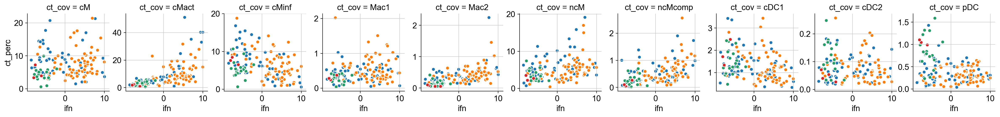

In [70]:
joined2_plot = joined2
joined2_plot.ct_cov = joined2_plot.ct_cov.astype('category')
joined2_plot.ct_cov = joined2_p3lot.ct_cov.cat.reorder_categories(['cM', 'cMact', 'cMinf', 'Mac1', 'Mac2', 'ncM', 'ncMcomp', 'cDC1', 'cDC2', 'pDC'])

g = sb.FacetGrid(joined2_plot, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "ifn", "ct_perc", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn.ct_cov.png")

# SLEDAI analysis

In [72]:
joined2.sledaiscore = joined2.sledaiscore.fillna(0)
joined2.ifn = joined2.ifn.fillna(0)

In [74]:
joined_pivot3_percs = joined2.pivot_table(index=['name',"disease_pop_site_cov","sledaiscore"], columns="ct_cov", values="ct_perc")

In [75]:
index_df = joined_pivot3_percs.index.to_frame(index=False)
df = joined_pivot3_percs.reset_index(drop=True)
joined_pivot3_percs = pd.merge(index_df, df, left_index=True, right_index=True)

In [76]:
print("Regression with all individuals with healthy controls set to 0 SLEDAI")
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    
    est=sm.OLS(joined_pivot3_percs.sledaiscore.astype(float),  sm.add_constant(joined_pivot3_percs[ct].astype(float)), missing="drop")
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor = joined_pivot3_percs.sledaiscore.corr(joined_pivot3_percs[ct])
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval)+', cor='+str(cor))
    
print("\nRegression with SLE only individuals")

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    
    sle_only = joined_pivot3_percs[joined_pivot3_percs.disease_pop_site_cov.str.contains("sle")]
    
    est=sm.OLS(sle_only.sledaiscore.astype(float),  sm.add_constant(sle_only[ct].astype(float)), missing="drop")
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor = sle_only.sledaiscore.corr(sle_only[ct])
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval)+', cor='+str(cor))
    
    
print("\nRegression with SLE asian individuals")

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    
    sle_only = joined_pivot3_percs[joined_pivot3_percs.disease_pop_site_cov.str.contains("sleASIANUCSF")]
    
    est=sm.OLS(sle_only.sledaiscore.astype(float),  sm.add_constant(sle_only[ct].astype(float)), missing="drop")
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor = sle_only.sledaiscore.corr(sle_only[ct])
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval)+', cor='+str(cor))
    
print("\nRegression with SLE white individuals")

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    
    sle_only = joined_pivot3_percs[joined_pivot3_percs.disease_pop_site_cov.str.contains("sleWHITEUCSF")]
    
    est=sm.OLS(sle_only.sledaiscore.astype(float),  sm.add_constant(sle_only[ct].astype(float)), missing="drop")
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor = sle_only.sledaiscore.corr(sle_only[ct])
    print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval)+', cor='+str(cor))

Regression with all individuals with healthy controls set to 0 SLEDAI
Cluster=cM, Beta=0.004053767034892741, R2=3.5828758910283476e-05, pvalue=0.9440427786516121, cor=0.00598571289908709
Cluster=cMact, Beta=0.12085658345594678, R2=0.1346657788251131, pvalue=8.207423346528199e-06, cor=0.3669683621582564
Cluster=cMinf, Beta=-0.1881097418593278, R2=0.06069643013321502, pvalue=0.0033432276613259222, cor=-0.24636645496742246
Cluster=Mac1, Beta=-0.3641804380083311, R2=0.0015346813329837339, pvalue=0.6470446800254589, cor=-0.03917500903616573
Cluster=Mac2, Beta=1.6342547379680963, R2=0.02428545002134508, pvalue=0.06597151115149585, cor=0.1558378966148645
Cluster=ncM, Beta=-0.047257349068436205, R2=0.002791031729991844, pvalue=0.5353075507664871, cor=-0.05283021606989738
Cluster=ncMcomp, Beta=0.9851590417329807, R2=0.019503095548144778, pvalue=0.09983325164251848, cor=0.139653483838195
Cluster=cDC1, Beta=-0.6025319560155824, R2=0.01930632766759177, pvalue=0.10157657211494871, cor=-0.1389472118

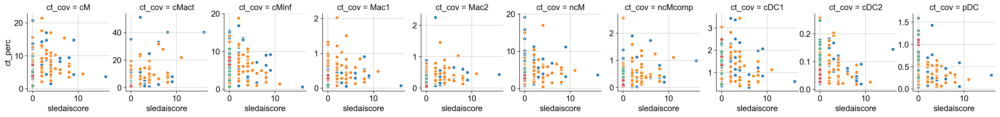

In [77]:
joined3_plot = joined2
joined3_plot.ct_cov = joined3_plot.ct_cov.astype('category')
##joined3_plot.ct_cov = joined3_plot.ct_cov.cat.reorder_categories(['cM', 'iM', 'ncM', 'actM', 'compM', 'Mac1', 'Mac2', 'cDC1', 'cDC2', 'pDC'])

g = sb.FacetGrid(joined3_plot, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "sledaiscore", "ct_perc", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/sledaiscore.ct_cov.png")

In [79]:
# joined3_plot = joined2
# joined3_plot.ct_cov = joined3_plot.ct_cov.astype('category')
# ##joined3_plot.ct_cov = joined3_plot.ct_cov.cat.reorder_categories(['cM', 'iM', 'ncM', 'actM', 'compM', 'Mac1', 'Mac2', 'cDC1', 'cDC2', 'pDC'])

# g = sb.FacetGrid(joined3_plot, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
# g = g.map(plt.scatter, "sliccscore", "ct_perc", edgecolor="w")
# g.fig.subplots_adjust(wspace=0.2)
# g.savefig(figdir+"/sliccscore.ct_cov.png")

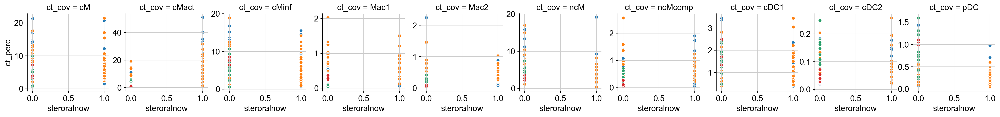

In [80]:
joined3_plot = joined2
joined3_plot.ct_cov = joined3_plot.ct_cov.astype('category')
##joined3_plot.ct_cov = joined3_plot.ct_cov.cat.reorder_categories(['cM', 'iM', 'ncM', 'actM', 'compM', 'Mac1', 'Mac2', 'cDC1', 'cDC2', 'pDC'])

g = sb.FacetGrid(joined3_plot, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap=10)
g = g.map(plt.scatter, "steroralnow", "ct_perc", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)

# Let's recompute the IFN score

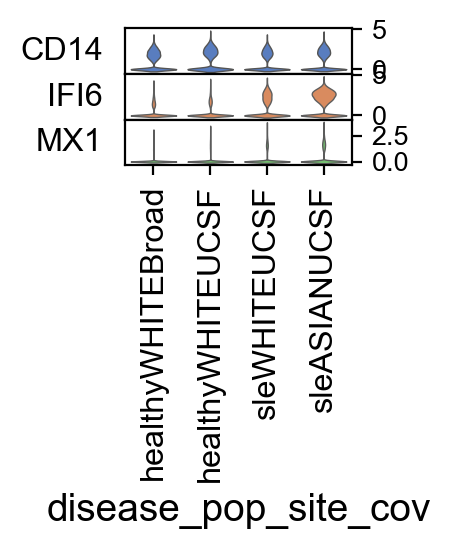

In [81]:
sc.pl.stacked_violin(adata, var_names=['CD14',"IFI6","MX1"], groupby='disease_pop_site_cov', swap_axes=True)

In [82]:
diffexp_annot = pd.read_csv("diffexp.annotations.txt", sep="\t", index_col=False)
##diffexp_annot.cluster = diffexp_annot.cluster.astype("category")

## remap the categories
# diffexp_annot.cluster[diffexp_annot.cluster == "Pan2"] = "CPan";
# diffexp_annot.cluster[diffexp_annot.cluster == "Pan1"] = "CLymph";
# diffexp_annot.cluster[diffexp_annot.cluster == "Down"] = "CT1";
# diffexp_annot.cluster[diffexp_annot.cluster == "Myeloid1"] = "CMye1";
# diffexp_annot.cluster[diffexp_annot.cluster == "Myeloid2"] = "CMye2";
# diffexp_annot.cluster[diffexp_annot.cluster == "M"] = "CMono";
# diffexp_annot.cluster[diffexp_annot.cluster == "T1"] = "CT2";
# diffexp_annot.cluster[diffexp_annot.cluster == "T2"] = "CT3";
diffexp_annot.cluster = diffexp_annot.cluster.astype("category")

In [83]:
for cluster_i in diffexp_annot.cluster.cat.categories:
    print(cluster_i)
    cluster_X = adata.X[:,adata.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster==cluster_i])];
    adata.obs[cluster_i] = np.sum(cluster_X, axis=1)
    

B
Lymph
Mono
Pan
T4
T8
ncM
pDC


saving figure to file ./figures.V6.1/umap.ifn.sle.png
saving figure to file ./figures.V6.1/umap.ifn.healthy.png


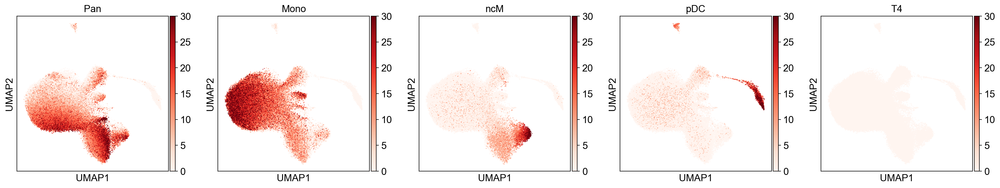

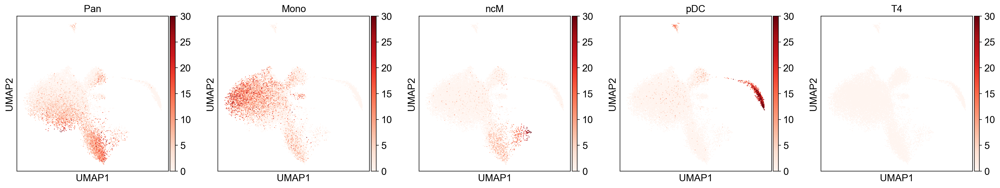

In [84]:
##fig,ax = plt.subplots(nrows=1,ncols=2, figsize=(10,5),sharex=True, sharey=True)
##fig.tight_layout()

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['Pan',"Mono", "ncM", "pDC", "T4"], size=5, vmin=0, color_map=plt.cm.Reds, vmax=30, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 0)], color=['Pan',"Mono", "ncM", "pDC", "T4"], color_map=plt.cm.Reds, size=5, vmin=0, vmax=30, ncols=5) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
# sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 1)], color=['all_ifn',"myeloid_ifn","cM_ifn"], palette="Greys", size=10) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['Pan',"Mono", "ncM", "pDC", "T4"], size=5, save='.ifn.sle.png', color_map=plt.cm.Reds,vmin=0, vmax=30, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 0)], color=['Pan',"Mono", "ncM", "pDC", "T4"], size=5, color_map=plt.cm.Reds,save='.ifn.healthy.png', vmin=0, vmax=30, ncols=5) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)


##sc.pl.umap(adata[adata.obs.disease_cov=="healthy",], color = "all_ifn", ax=ax[1])                                                      

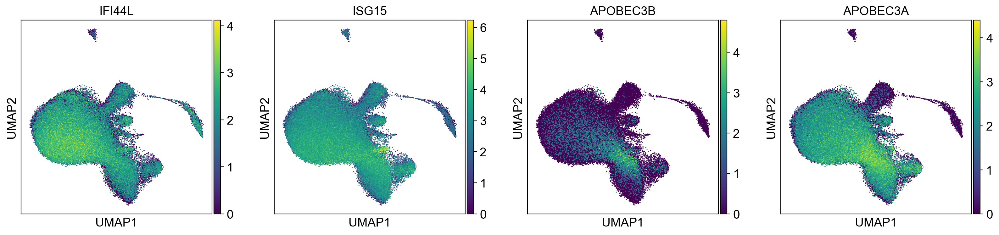

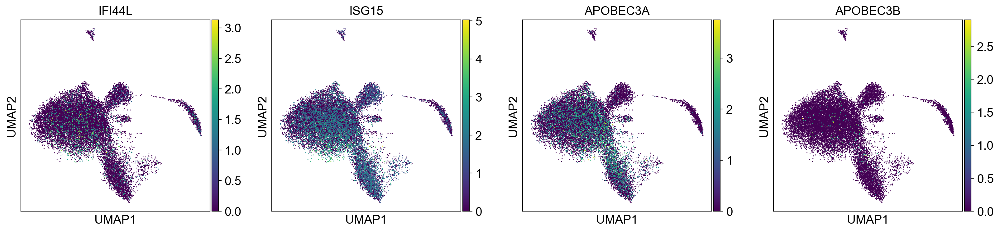

In [85]:
##fig,ax = plt.subplots(nrows=1,ncols=2, figsize=(10,5),sharex=True, sharey=True)
##fig.tight_layout()

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['IFI44L',"ISG15","APOBEC3B","APOBEC3A"], size=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 0)], color=['IFI44L',"ISG15","APOBEC3A","APOBEC3B"], size=5) ##,vmin=min(adata.obs.all_ifn), vmax=maex(adata.obs.all_ifn)*.75)
##sc.pl.umap(adata[(adata.obs.disease_cov=="healthy") & (adata.obs.Broad == 1)], color=['IFI44L',"ISG15","APOBEC3B"], size=10) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)



##sc.pl.umap(adata[adata.obs.disease_cov=="healthy",], color = "all_ifn", ax=ax[1])                                                      

saving figure to file ./figures.V6.1/umap.types.png


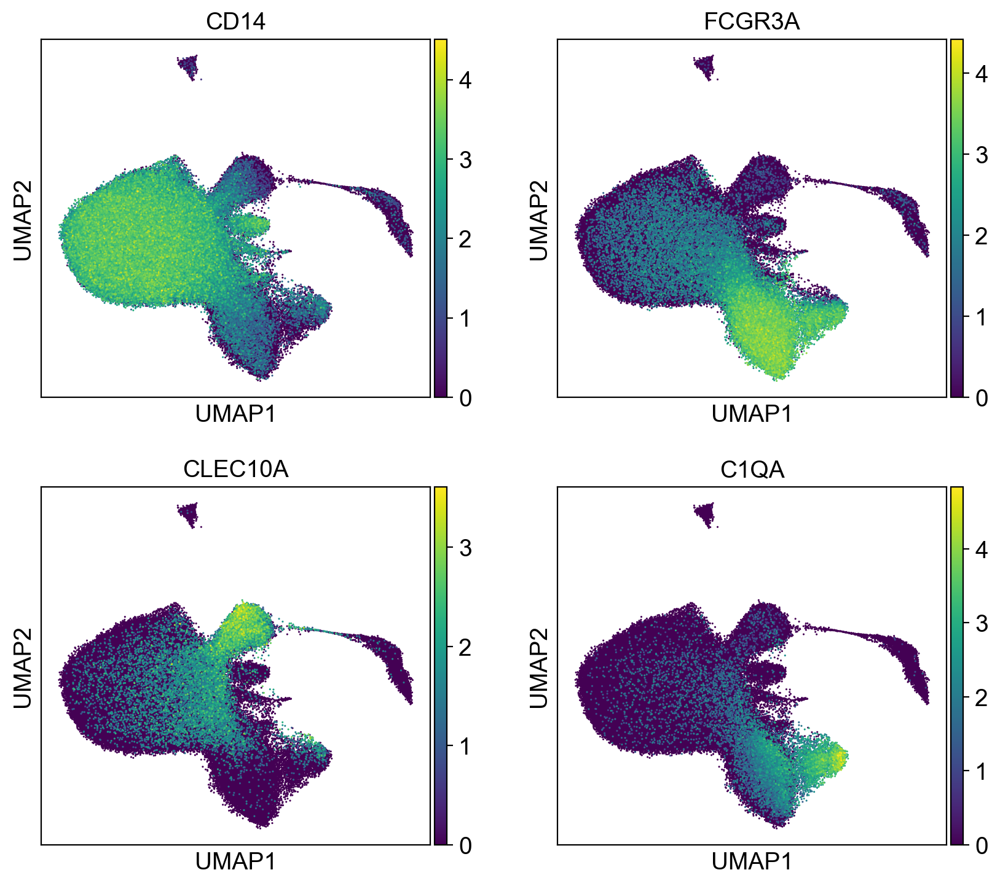

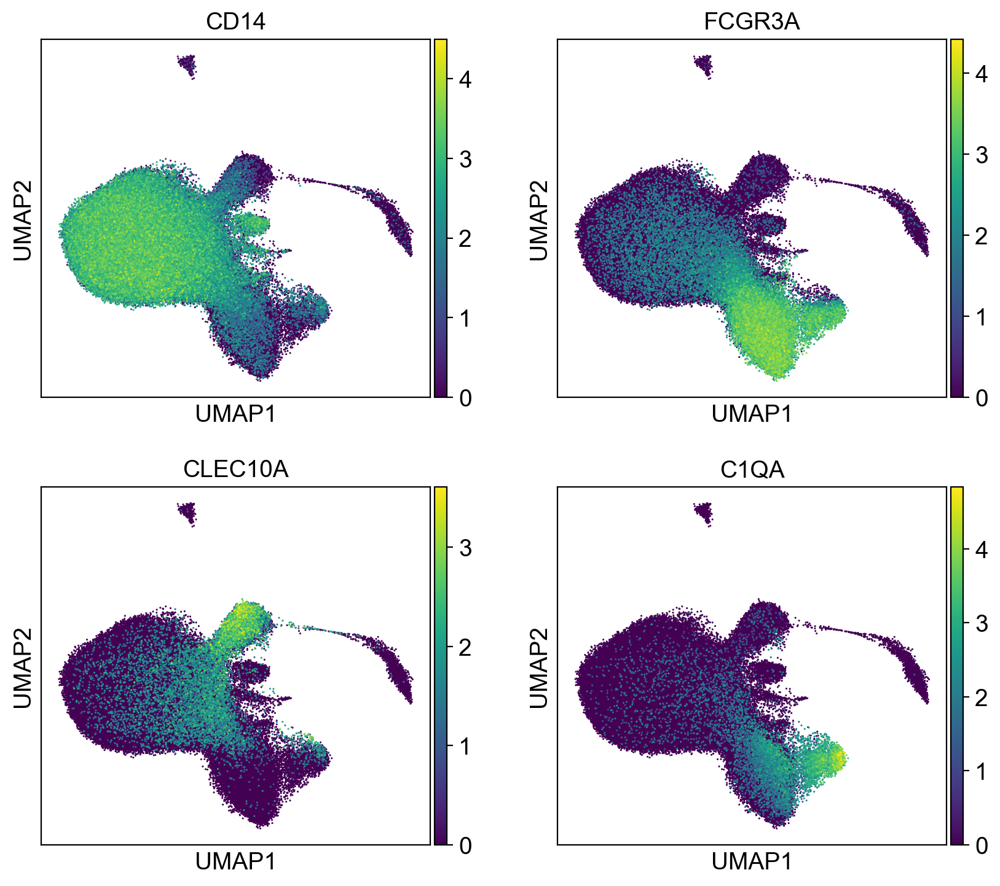

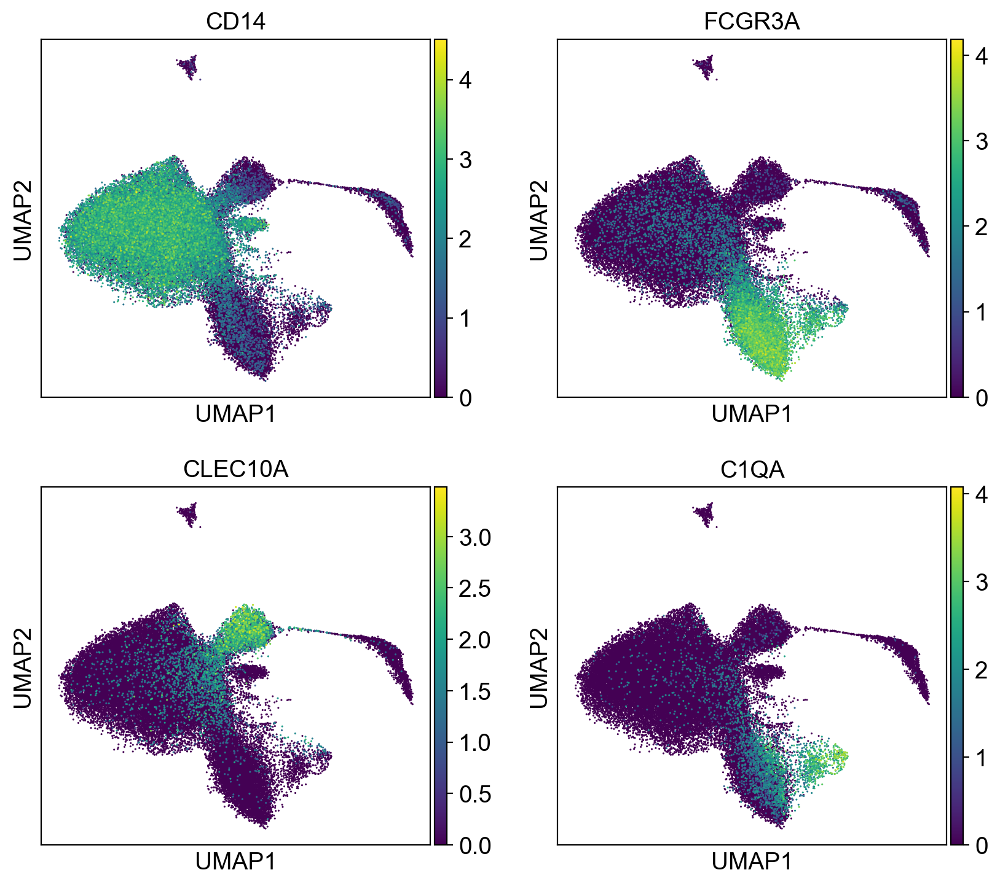

In [86]:
markers = sc.pl.umap(adata, color=['CD14',"FCGR3A","CLEC10A","C1QA"], palette="Greys", size=5,ncols=2) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata, color=['CD14',"FCGR3A","CLEC10A","C1QA"], palette="Greys", size=5, save='.types.png',ncols=2)
sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD14',"FCGR3A","CLEC10A","C1QA"], palette="Greys", size=5,ncols=2) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD14',"FCGR3A","CLEC10A","C1QA"], palette="Greys", size=5,ncols=2) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

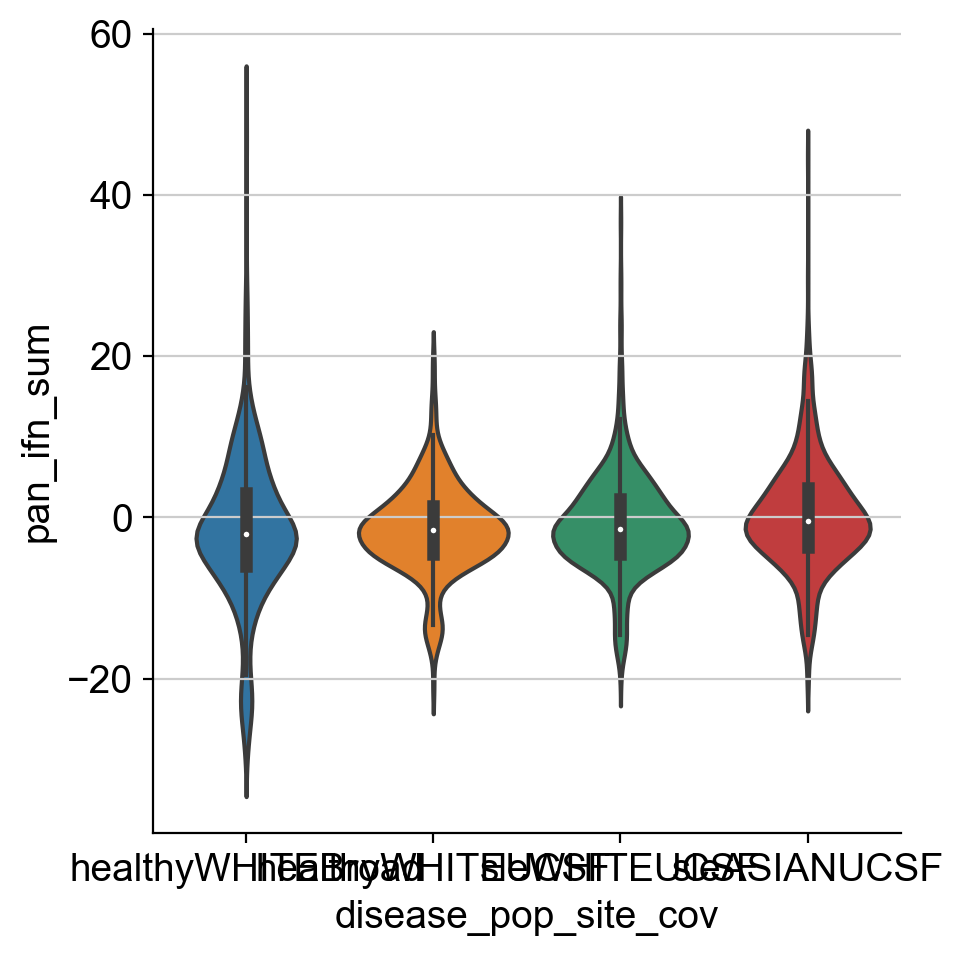

In [87]:
plot_df = adata.obs.groupby(['ind_cov','disease_pop_site_cov','louvain'])['Pan'].mean()
plot_df = plot_df.reset_index(name='pan_ifn_sum')

sb.catplot(x="disease_pop_site_cov", y="pan_ifn_sum", data=plot_df, kind='violin', dodge=False, sharex=False, sharey=True)

Cluster=0,Beta=-0.2712820428171573, pvalue=0.5318290274690891
Cluster=1,Beta=-1.4604888763648123, pvalue=3.7916278091880094e-06
Cluster=2,Beta=1.5095534041674201, pvalue=0.008906335292332531
Cluster=3,Beta=-1.4558095348429152, pvalue=0.0006784676510076739
Cluster=4,Beta=-0.2087904307376442, pvalue=0.7637477913408823
Cluster=5,Beta=-1.3486767278080256, pvalue=0.0007965408513133002
Cluster=6,Beta=0.12024052551751868, pvalue=0.8410587281050302
Cluster=7,Beta=-4.000136256378237, pvalue=4.020666701255899e-12


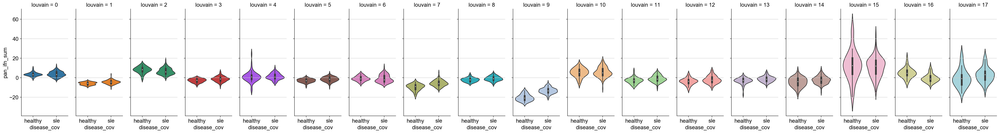

In [88]:
plot_df = adata.obs.groupby(['ind_cov','disease_cov','louvain'])['Pan'].mean()
plot_df = plot_df.reset_index(name='pan_ifn_sum')

sb.catplot(x="disease_cov", y="pan_ifn_sum", hue='louvain', data=plot_df, kind='violin', col='louvain', dodge=False, aspect=0.4, sharex=False, sharey=True)

##n_cts=ct_df.shape[1]-1
for cluster_i in list(range(0,8)):
    cluster = plot_df.louvain.cat.categories[cluster_i]
    pan_ifn_sum = plot_df.pan_ifn_sum[plot_df.louvain == cluster]
    disease = plot_df.disease_cov[plot_df.louvain==cluster].astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    est=sm.OLS(pan_ifn_sum.astype(float), disease.astype(float), missing='drop')
    ##est=sm.OLS("all_ifn~disease_cov", data=adata.obs.input,missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Cluster='+str(cluster)+',Beta='+str(effect)+', pvalue='+str(pval))

Cluster=0,Beta=-0.3470241360252013, pvalue=0.353623843755425
Cluster=1,Beta=-1.3508536403434102, pvalue=2.964790066107382e-06
Cluster=2,Beta=1.1427592566478892, pvalue=0.029318576730484224
Cluster=3,Beta=-1.3461950608685556, pvalue=0.0004066824704641122
Cluster=4,Beta=-0.1736851244853021, pvalue=0.781640661368422
Cluster=5,Beta=-1.3332748645626777, pvalue=0.0004031982405051195
Cluster=6,Beta=-0.10796968370831178, pvalue=0.8369783941545172
Cluster=7,Beta=-3.72838432362593, pvalue=1.1864860346041609e-12


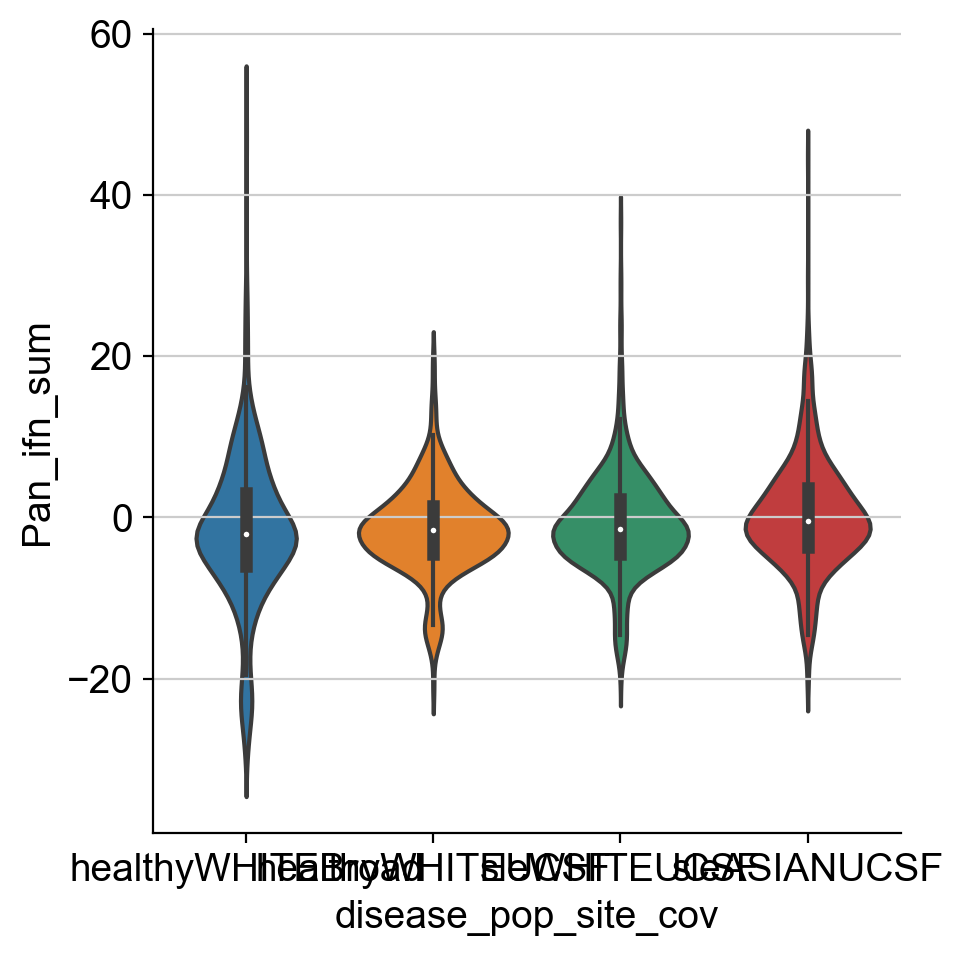

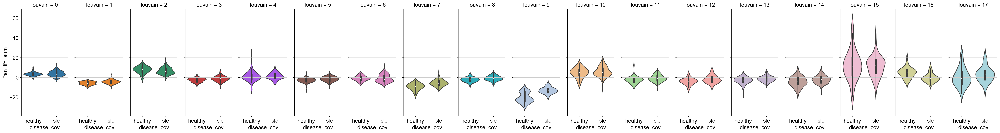

In [89]:
plot_df = adata.obs.groupby(['ind_cov','disease_pop_site_cov','disease_cov','louvain'])['Pan'].mean()
plot_df = plot_df.reset_index(name='Pan_ifn_sum')

sb.catplot(x="disease_pop_site_cov", y="Pan_ifn_sum", data=plot_df, kind='violin', dodge=False, sharex=False, sharey=True)
sb.catplot(x="disease_cov", y="Pan_ifn_sum", hue='louvain', data=plot_df, kind='violin', col='louvain', dodge=False, aspect=0.4, sharex=False, sharey=True)

##n_cts=ct_df.shape[1]-1
for cluster_i in list(range(0,8)):
    cluster = plot_df.louvain.cat.categories[cluster_i]
    Pan_ifn_sum = plot_df.Pan_ifn_sum[plot_df.louvain == cluster]
    disease = plot_df.disease_cov[plot_df.louvain==cluster].astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    est=sm.OLS(Pan_ifn_sum.astype(float), disease.astype(float), missing='drop')
    ##est=sm.OLS("myeloid_ifn~disease_cov", data=adata.obs.input,missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Cluster='+str(cluster)+',Beta='+str(effect)+', pvalue='+str(pval))

Cluster=0,Beta=-2.119209438361405, pvalue=5.914663362427595e-15
Cluster=1,Beta=-2.658085697682601, pvalue=5.206249821254994e-16
Cluster=2,Beta=-0.6628148825945775, pvalue=0.03607414438481715
Cluster=3,Beta=-1.6568069362477775, pvalue=3.1576999734813723e-07
Cluster=4,Beta=-0.7369597323214677, pvalue=0.38511067147583666
Cluster=5,Beta=-1.17450091620894, pvalue=0.0037729714054298537
Cluster=6,Beta=0.2309932222569661, pvalue=0.5492041604328237
Cluster=7,Beta=-2.9034832778405253, pvalue=1.9195705898639198e-08


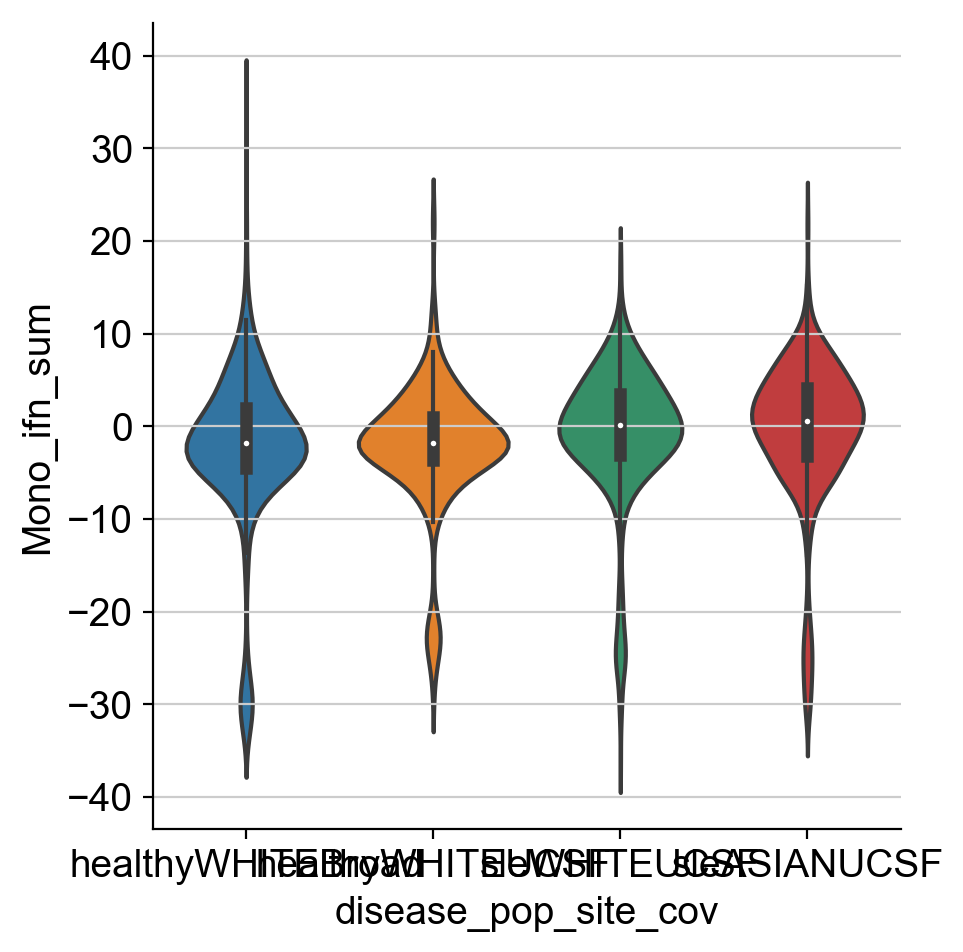

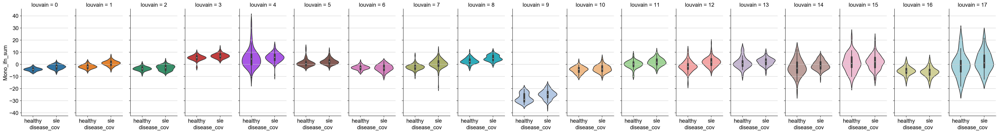

In [90]:
plot_df = adata.obs.groupby(['ind_cov','disease_pop_site_cov','disease_cov','louvain'])['Mono'].mean()
plot_df = plot_df.reset_index(name='Mono_ifn_sum')

sb.catplot(x="disease_pop_site_cov", y="Mono_ifn_sum", data=plot_df, kind='violin', dodge=False, sharex=False, sharey=True)
sb.catplot(x="disease_cov", y="Mono_ifn_sum", hue='louvain', data=plot_df, kind='violin', col='louvain', dodge=False, aspect=0.4, sharex=False, sharey=True)

##n_cts=ct_df.shape[1]-1
for cluster_i in list(range(0,8)):
    cluster = plot_df.louvain.cat.categories[cluster_i]
    Mono_ifn_sum = plot_df.Mono_ifn_sum[plot_df.louvain == cluster]
    disease = plot_df.disease_cov[plot_df.louvain==cluster].astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    est=sm.OLS(Mono_ifn_sum.astype(float), disease.astype(float), missing='drop')
    ##est=sm.OLS("myeloid_ifn~disease_cov", data=adata.obs.input,missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Cluster='+str(cluster)+',Beta='+str(effect)+', pvalue='+str(pval))

## Let's now do DPT

In [91]:
## let's just get a smaller dataset
adata_mono = adata[~adata.obs.ct_cov.isin(["cDC1",'cDC2','pDC','Mac1','Mac2',"cMact",'cMinf','ncMcomp'])].copy()

In [92]:
sc.tl.pca(adata_mono, svd_solver='arpack')

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:10.04)


In [93]:
## denoise
sc.tl.diffmap(adata_mono)
sc.pp.neighbors(adata_mono, n_neighbors=10, use_rep='X_diffmap')

computing Diffusion Maps using n_comps=15(=n_dcs)
    eigenvalues of transition matrix
    [ 1.          0.9956825   0.957957    0.94207734  0.9415132   0.92308956
      0.9189242   0.91412514  0.91031706  0.90153635  0.89795405  0.89595866
     -0.9006326  -0.91071236 -0.9414245 ]
    finished (0:00:02.24)
computing neighbors


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/umap/rp_tree.py:450: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "make_euclidean_tree" failed type inference due to: Cannot unify RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none) and RandomProjectionTreeNode(none, bool, array(float32, 1d, C), float64, RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none), RandomProjectionTreeNode(array(int64, 1d, C), bool, none, none, none, none)) for '$14.16', defined at /Users/yimmieg/anaconda3/lib/python3.6/site-packages/umap/rp_tree.py (457)

File "../../../../../../../anaconda3/lib/python3.6/site-packages/umap/rp_tree.py", line 457:
def make_euclidean_tree(data, indices, rng_state, leaf_size=30):
    <source elided>

        left_node = make_euclidean_tree(data, left_indices, rng_state, leaf_size)
        ^

[1] During: resolving callee type: recursive(type(CPUDispatcher(<function make_euclid

    finished (0:00:17.32)


In [94]:
sc.tl.louvain(adata_mono, resolution=1.0)
sc.tl.paga(adata_mono, groups='louvain')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:07.44)
running PAGA
    finished (0:00:04.58)


    number of colors in `.uns[louvain'_colors']` smaller than number of categories, falling back to palette


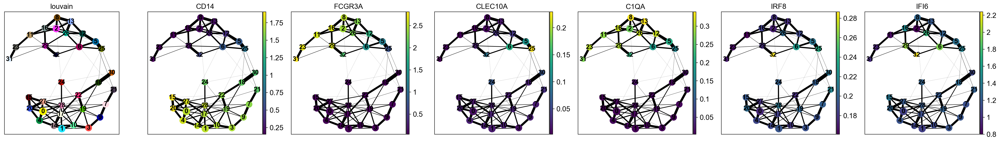

In [95]:
sc.pl.paga(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'])

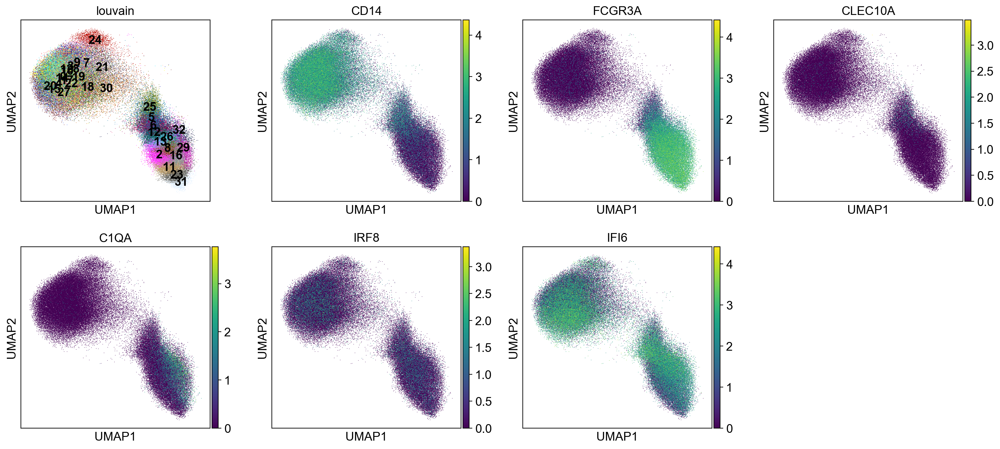

In [96]:
sc.pl.umap(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'], legend_loc='on data')

In [97]:
# sc.tl.draw_graph(adata_mono, init_pos='paga')
# sc.pl.draw_graph(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'], legend_loc='on data')

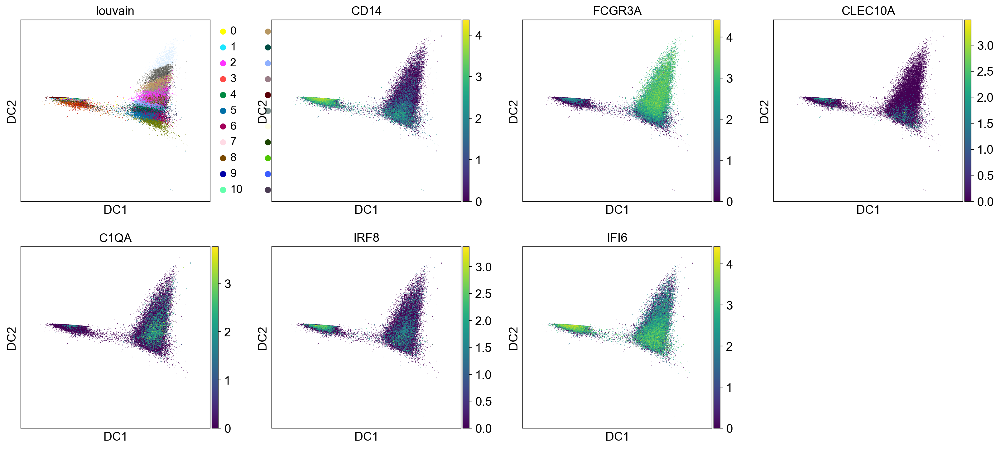

In [98]:
sc.pl.diffmap(adata_mono, color=['louvain', 'CD14',"FCGR3A","CLEC10A", 'C1QA', 'IRF8', 'IFI6'])

In [99]:
adata_mono.uns['iroot'] = np.flatnonzero((adata_mono.obs['louvain']  == '17') | (adata_mono.obs['louvain']  == '14'))[0]
sc.tl.dpt(adata_mono, n_dcs=15)

computing Diffusion Pseudotime using n_dcs=15
    finished (0:00:00.01)


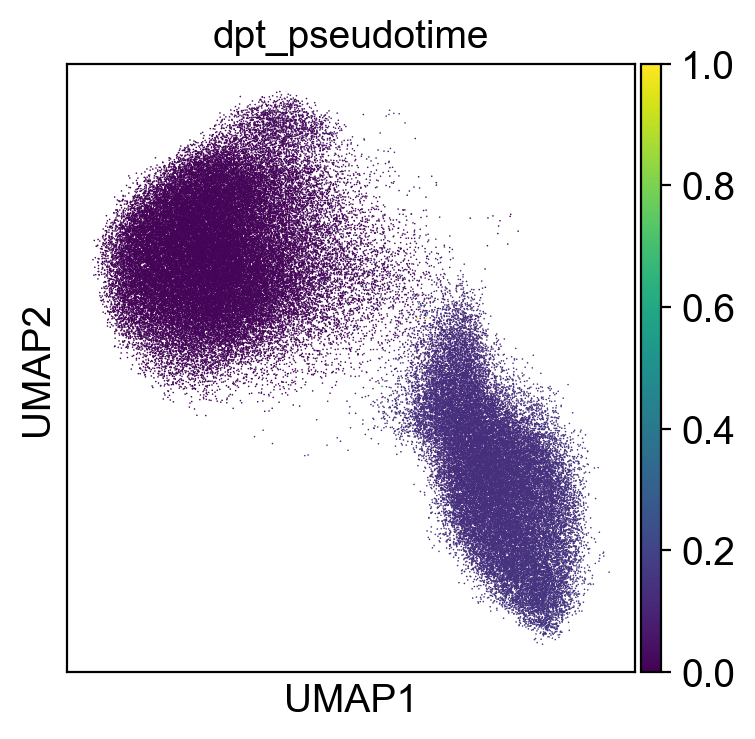

In [100]:
sc.pl.umap(adata_mono, color=['dpt_pseudotime'], legend_loc='on data')

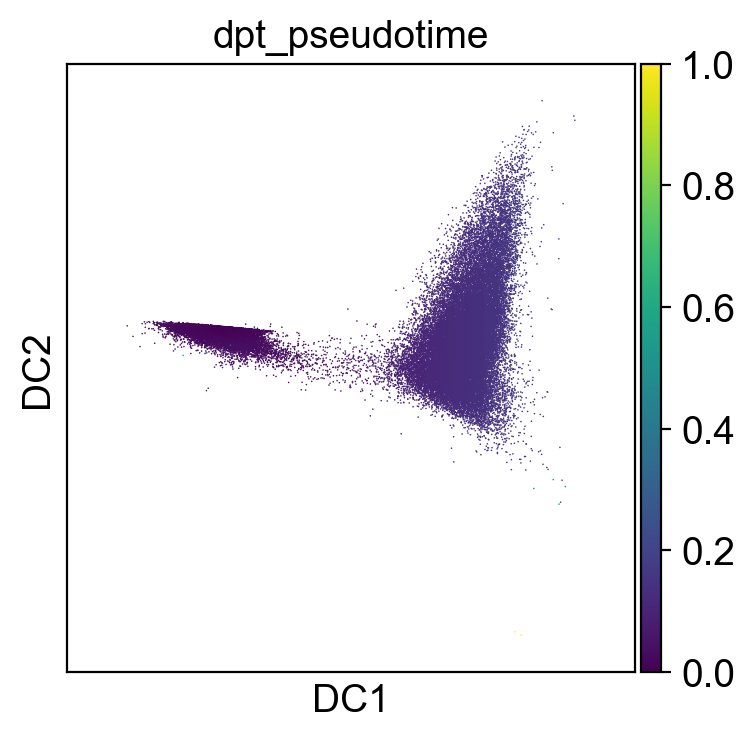

In [101]:
sc.pl.diffmap(adata_mono, color=['dpt_pseudotime'])

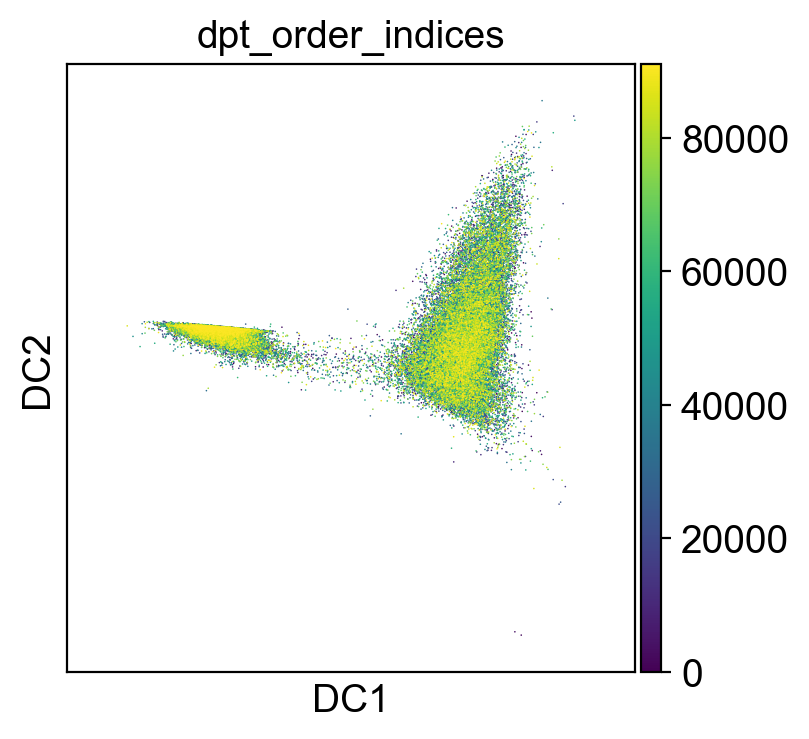

In [102]:
adata_mono.obs['dpt_order_indices'] = adata_mono.obs['dpt_pseudotime'].argsort()
adata_mono.uns['dpt_changepoints'] = np.ones(adata_mono.obs['dpt_order_indices'].shape[0] - 1)
sc.pl.diffmap(adata_mono, color=['dpt_order_indices'])

In [103]:
adata_mono_small = adata_mono[1:100,adata_mono.var_names.isin(["IFI6","MX1"])]

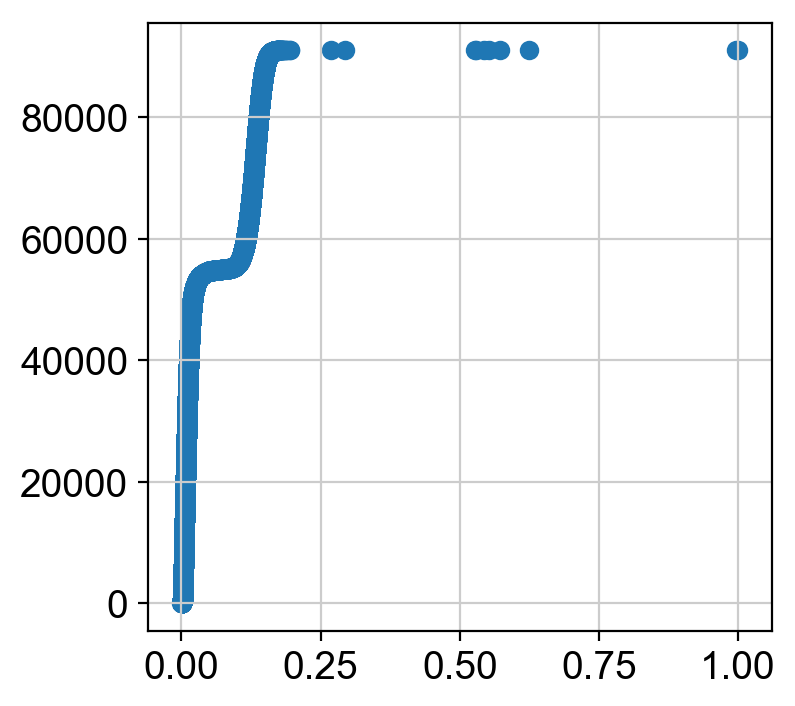

In [104]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.obs['dpt_pseudotime'].rank())

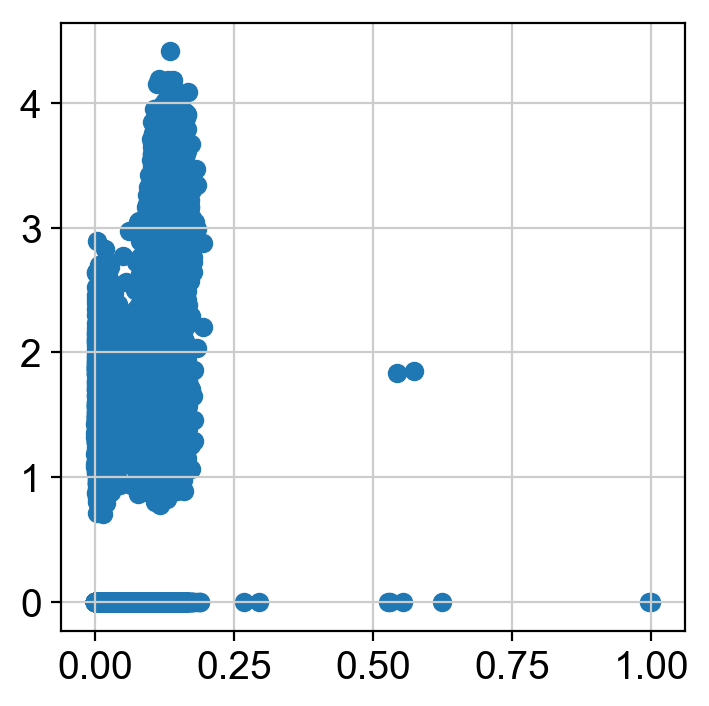

In [105]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.raw[:,"FCGR3A"].X)

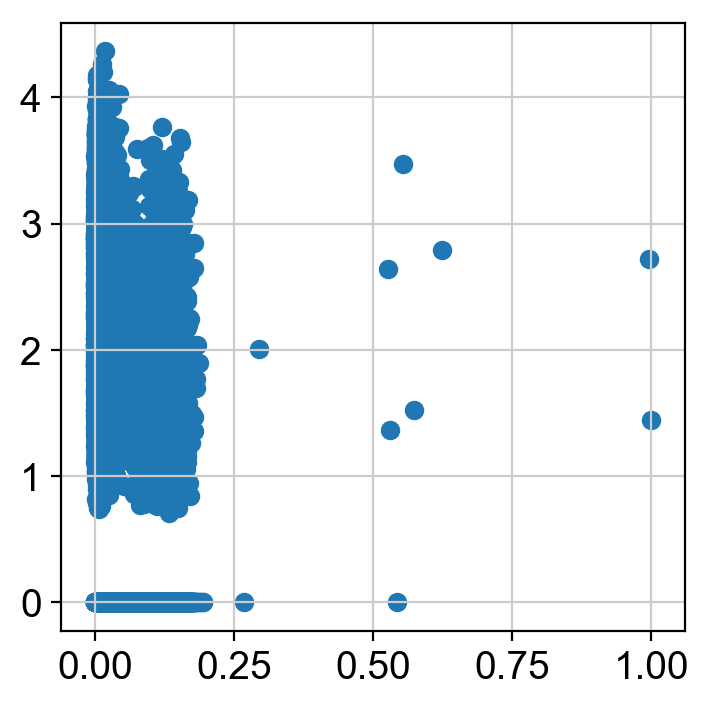

In [106]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.raw[:,"CD14"].X)

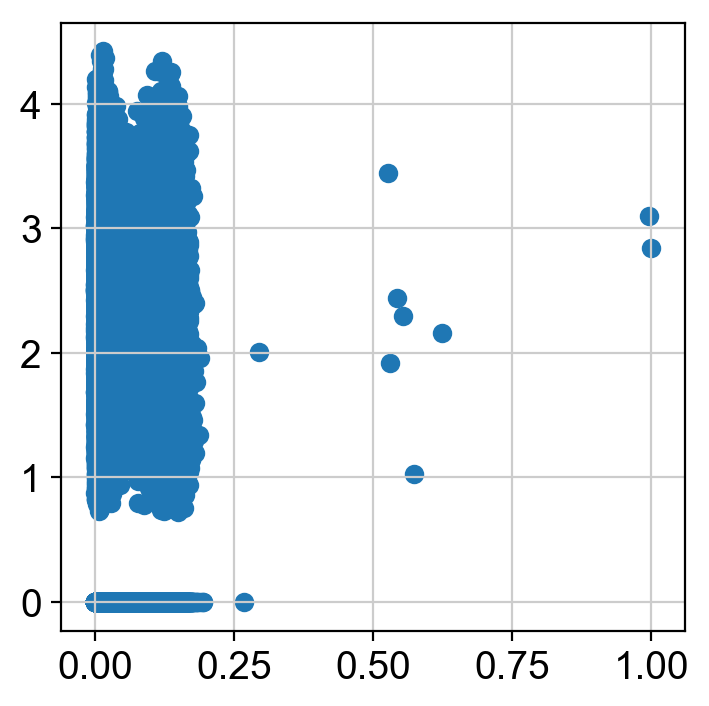

In [107]:
plt.scatter(adata_mono.obs['dpt_pseudotime'], adata_mono.raw[:,"IFI6"].X)

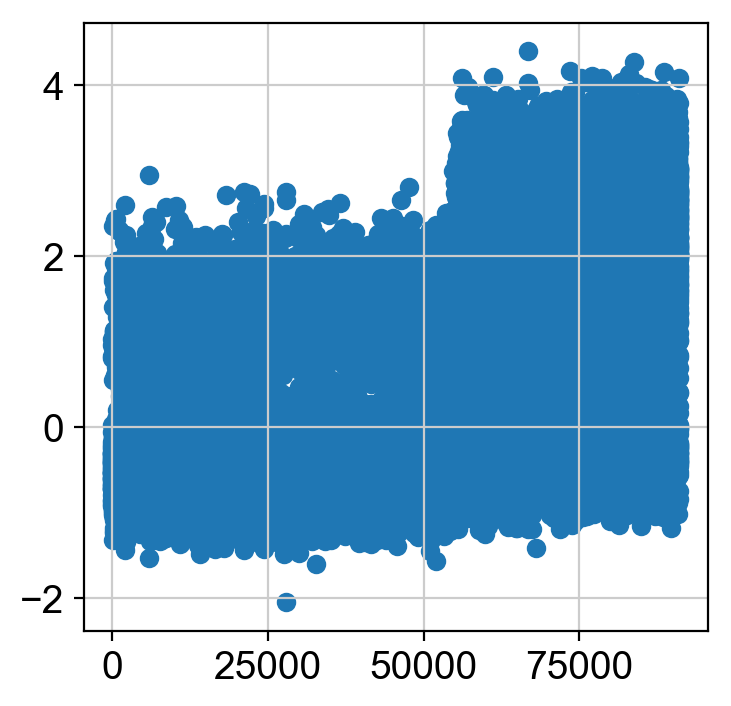

In [108]:
plt.scatter(adata_mono.obs['dpt_pseudotime'].rank(), adata_mono[:,"FCGR3A"].X)

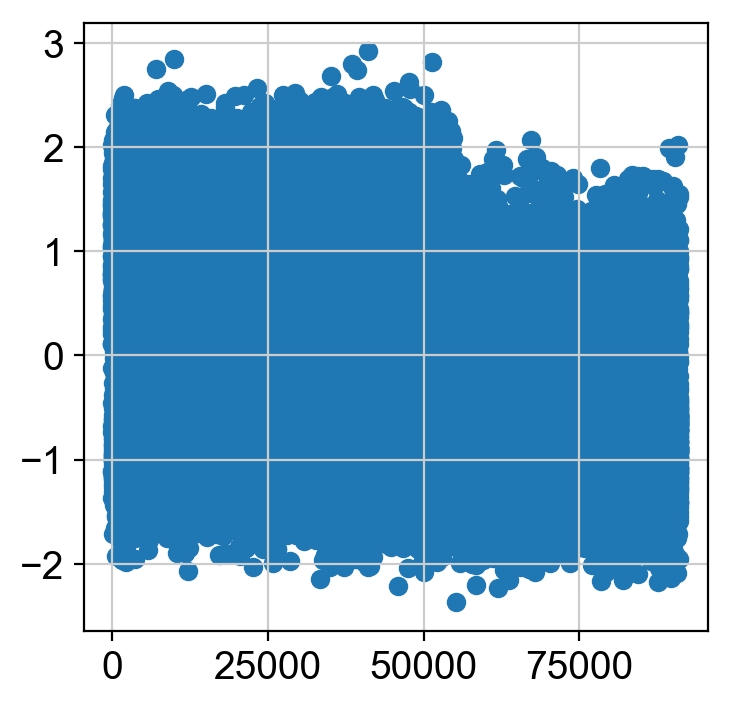

In [109]:
plt.scatter(adata_mono.obs['dpt_pseudotime'].rank(), adata_mono[:,"CD14"].X)

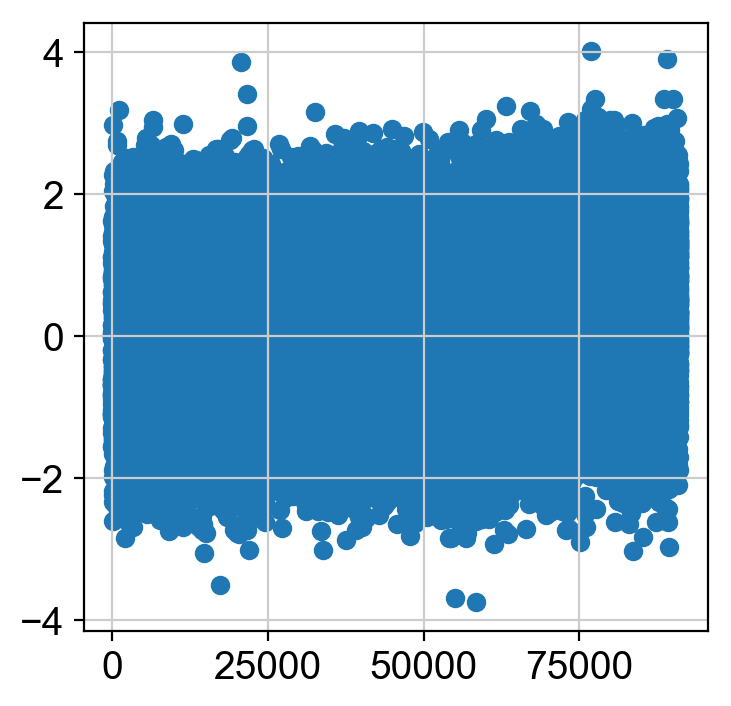

In [110]:
plt.scatter(adata_mono.obs['dpt_pseudotime'].rank(),adata_mono[:,"IFI6"].X)

In [111]:
diffexp_annot.cluster.unique()

[Pan, Mono, ncM, pDC, T4, T8, Lymph, B]
Categories (8, object): [Pan, Mono, ncM, pDC, T4, T8, Lymph, B]

In [113]:
# PC = np.asarray(sc.pp.pca(data[:,genes_ncm_ifn].X, n_comps=1, copy=True)).reshape(-1,)
# data.obs['PC_axis4'] = list(PC)


In [126]:
colors = ["#fee8c8","#fdbb84","#ef6548","#990000"]
data = adata.copy();

# Slice matrix to remove people not in Monocyte results
clues_clinical2 = pd.read_table("v2.clinical.data.txt", index_col=False)
clues_clinical2 = clues_clinical2[clues_clinical2['genotypeid'].isin(data.obs['ind_cov'].values.tolist())]
ifn_genes = pd.read_csv('ifn.lupus.crow.etal.txt', header=None)

genes_lineage = data.var_names[data.var_names.isin(['CD14', 'FCGR3A'])].tolist()
genes_pan_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["Pan"])])].tolist()
genes_mono_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["Mono"])])].tolist()
genes_ncm_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["ncM"])])].tolist()
genes_pdc_ifn = data.var_names[data.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster.isin(["pDC"])])].tolist()
genes_ifn = data.var_names[data.var_names.isin(ifn_genes[0])].tolist()

# Order cells
PC = np.asarray(sc.pp.pca(data[:,genes_lineage].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis1'] = list(PC)
PC = np.asarray(sc.pp.pca(data[:,genes_pan_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis2'] = list(PC)
PC = np.asarray(sc.pp.pca(data[:,genes_mono_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis3'] = list(-PC)
PC = np.asarray(sc.pp.pca(data[:,genes_ncm_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis4'] = list(-PC)
PC = np.asarray(sc.pp.pca(data[:,genes_pdc_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis5'] = list(PC)
##PC = np.asarray(sc.pp.pca(data[:,genes_monocytes_ifn].X, n_comps=1, copy=True)).reshape(-1,)
PC = np.asarray(sc.pp.pca(data[:,genes_ifn].X, n_comps=1, copy=True)).reshape(-1,)
data.obs['PC_axis6'] = list(PC)

ind_healthy = data.obs['ind_cov'][data.obs['disease_cov']=='healthy'].tolist()
healthyall_axis1 = np.asarray(data.obs['PC_axis1'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis2 = np.asarray(data.obs['PC_axis2'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis3 = np.asarray(data.obs['PC_axis3'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis4 = np.asarray(data.obs['PC_axis4'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis5 = np.asarray(data.obs['PC_axis5'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())
healthyall_axis6 = np.asarray(data.obs['PC_axis6'][data.obs['ind_cov'].isin(ind_healthy)].values.tolist())

# Some SLEDAI scores to cut at
SLEDAI = [np.percentile(clues_clinical2['sledaiscore'].tolist(),25), np.percentile(clues_clinical2['sledaiscore'].tolist(),50), np.percentile(clues_clinical2['sledaiscore'].tolist(),75), np.percentile(clues_clinical2['sledaiscore'].tolist(),100)]
print(SLEDAI)
##colors = ['r', 'g', 'k', 'y', 'm']
sleall_axis1 = {};
sleall_axis2 = {};
sleall_axis3 = {};
sleall_axis4 = {};
sleall_axis5 = {};
sleall_axis6 = {};

for ii in range(len(SLEDAI)):
    if ii == SLEDAI[0]:
        disease_sub = clues_clinical2['genotypeid'][clues_clinical2['sledaiscore'] <= SLEDAI[ii]]
    else:
        disease_sub = clues_clinical2['genotypeid'][(clues_clinical2['sledaiscore'] <= SLEDAI[ii]) & (clues_clinical2['sledaiscore'] > SLEDAI[ii-1])]

    ind_sle = data.obs['ind_cov'][data.obs['ind_cov'].isin(disease_sub.values.tolist())].tolist()
    
    sleall_axis1[str(ii)] = np.asarray(data.obs['PC_axis1'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis2[str(ii)] = np.asarray(data.obs['PC_axis2'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis3[str(ii)] = np.asarray(data.obs['PC_axis3'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis4[str(ii)] = np.asarray(data.obs['PC_axis4'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis5[str(ii)] = np.asarray(data.obs['PC_axis5'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())
    sleall_axis6[str(ii)] = np.asarray(data.obs['PC_axis6'][data.obs['ind_cov'].isin(ind_sle)].values.tolist())

## 2D plot

fig,ax = plt.subplots(nrows=1,ncols=5, sharex=True, sharey=True);

for ii in range(len(SLEDAI)):
    plt.subplot(1,5,ii+1);
    p1 = sb.kdeplot(sleall_axis1[str(ii)], sleall_axis2[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
    ax = plt.gca()
    ax.set_title(ii)
    ##ax.legend()
    ax.set_xlabel('CD14 --> CD16')
    ax.set_ylabel('Low IFN --> Hign IFN')
    ax.axis([-2.5,2.5,-4,5])
    ax.grid(False)
    ##ax.set_aspect('equal')

plt.subplot(1,5,5)
p1 = sb.kdeplot(healthyall_axis1, healthyall_axis2, color="b", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('CD14 --> CD16')
ax.set_ylabel('Low IFN --> Hign IFN')
ax.axis([-2.5,2.5,-4,5])
ax.grid(False)
##ax.set_aspect('equal')

plt.savefig(figdir+'ALLSLEDAI.2D.png', width=15, height=3)
plt.close()

## 1D lineage

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis1[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis1, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('CD14 --> CD16')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.lineage.png', width=5, height=5)
plt.close()

## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis2[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis2, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.pan_ifn.png', width=5, height=5)
plt.close()


## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis3[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis3, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.mono_ifn.png', width=5, height=5)
plt.close()


## ncm
fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis4[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis4, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-2,2)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.ncm_ifn.png', width=5, height=5)
plt.close()


## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis5[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis5, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-2,2)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.pdc_ifn.png', width=5, height=5)
plt.close()

## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis6[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False)
p1 = sb.kdeplot(healthyall_axis6, color="#006d2c", label='healthy', shade=False, shade_lowest=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.crow_ifn.png', width=5, height=5)
plt.close()


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:5: FutureWarning: read_table is deprecated, use read_csv instead, passing sep='\t'.
  """


Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 1
    finished (0:00:00.03)
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 1
    finished (0:00:00.19)
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing PCA with n_comps = 1
    finished (0:00:00.27)
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducib

In [127]:
colors = ["#fcbba1","#fb6a4a","#cb181d","#67000d"]

## 1D lineage

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis1[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis1, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('CD14 --> CD16')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.lineage.png', width=5, height=5)
plt.close()

## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis2[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis2, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.pan_ifn.png', width=5, height=5)
plt.close()


## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis3[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis3, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.mono_ifn.png', width=5, height=5)
plt.close()


## ncm
fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis4[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis4, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-2,2)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.ncm_ifn.png', width=5, height=5)
plt.close()


## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis5[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis5, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-2,2)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.pdc_ifn.png', width=5, height=5)
plt.close()

## 1D ifn

fig,ax = plt.subplots();
for ii in range(len(SLEDAI)):
    p1 = sb.kdeplot(sleall_axis6[str(ii)], color=colors[ii], label=str(SLEDAI[ii]), shade=False, shade_lowest=False, legend=False)
p1 = sb.kdeplot(healthyall_axis6, color="#006d2c", label='healthy', shade=False, shade_lowest=False, legend=False)
plt.xlim(-7,7)
ax = plt.gca()
ax.set_title(ii)
##ax.legend()
ax.set_xlabel('Low IFN --> Hign IFN')
ax.grid(False)
##ax.set_aspect('equal')
plt.savefig(figdir+'ALLSLEDAI.crow_ifn.png', width=5, height=5)
plt.close()


[(0, 0.5)]

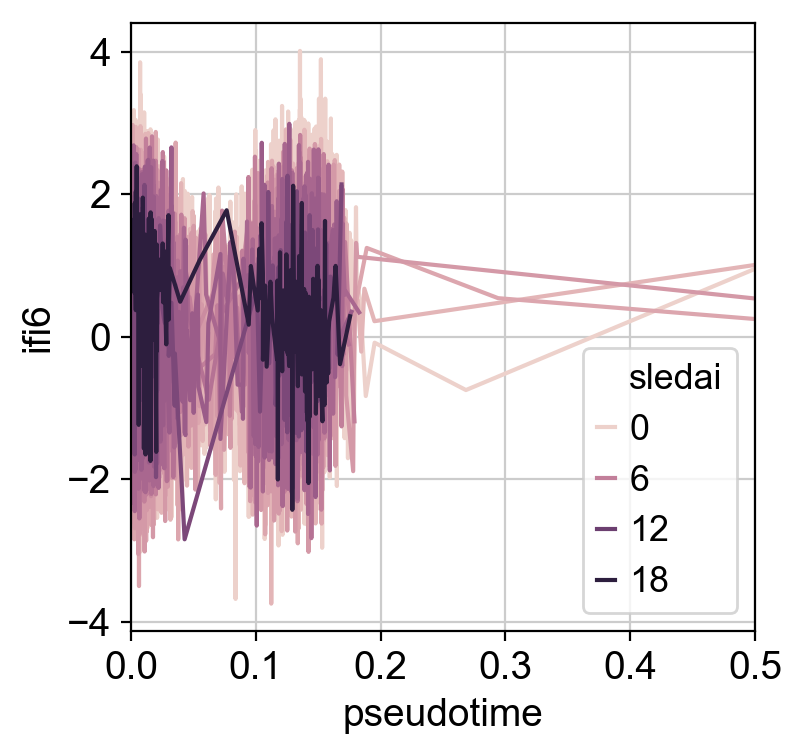

In [116]:
bdata_lineage = pd.DataFrame({"ifi6":np.asarray(adata_mono[:, "IFI6"].X).reshape(-1,), "pseudotime":adata_mono.obs["dpt_pseudotime"], "sledai":adata_mono.obs["SLEDAI"].astype("int64")})
out = sb.lineplot(x="pseudotime", y="ifi6", hue="sledai", data=bdata_lineage)
out.set(xlim=(0,0.5))